## HOMEWORK 3

### Problemi inversi

Utilizzare la funzione gravity del file examples.py per creare un problema test.

1. Visualizzare le condizioni discrete di Picard.

2. Calcolare la soluzione naive e visualizzarla.

3. Calcolare la soluzione regolarizzata con TSVD e visualizzarla. Scegliere
il parametro utilizzando le condizioni di Picard.

4. Calcolare la soluzione regolarizzata con Tikhonov e visualizzarla.
Scegliere il parametro utilizzando il principio di massima Discrepanza
e utilizzando un metodo euristico trial and error. Quali considerazioni posso fare?

Ripetere i punti precedenti per tre-quattro diversi livelli di rumore, nell’intervallo
$ [0, 0.1] $ (estremi compresi).

#### SOLUZIONE:

Iniziamo creando, come richiesto, il problema test utilizzando la funzione gravity del file examples.py. Fissiamo $ n = 30 $ come dimensione del problema e partiamo con 0.05 come livello di rumore.

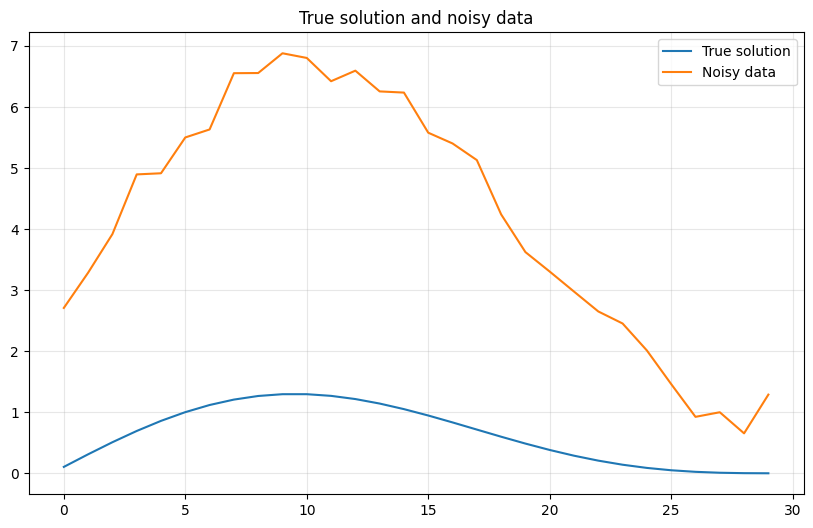

In [245]:
from ProblemiInversi import examples, operators, solvers, utilities
import numpy as np
import matplotlib.pyplot as plt

n: int = 30
noise_level: float = 0.05

A, x = examples.gravity(n)

y = A @ x
y_delta = y + utilities.gaussian_noise(y, noise_level)

plt.figure(figsize=(10, 6))
plt.plot(x, label='True solution')
plt.plot(y_delta, label='Noisy data')
plt.title('True solution and noisy data')
plt.grid(alpha=0.3)
plt.legend()
plt.show()

##### 1. Visualizzare le condizioni discrete di Picard

Visualizziamo con un grafico le condizioni discrete di Picard. Si tratta di visualizzare contemporaneamente i valori singolari $\sigma_i$, i valori $u_i^Ty^\delta$ (coefficienti di Fourier) e i coefficienti della soluzione $u_i^Ty^\delta / \sigma_i$.

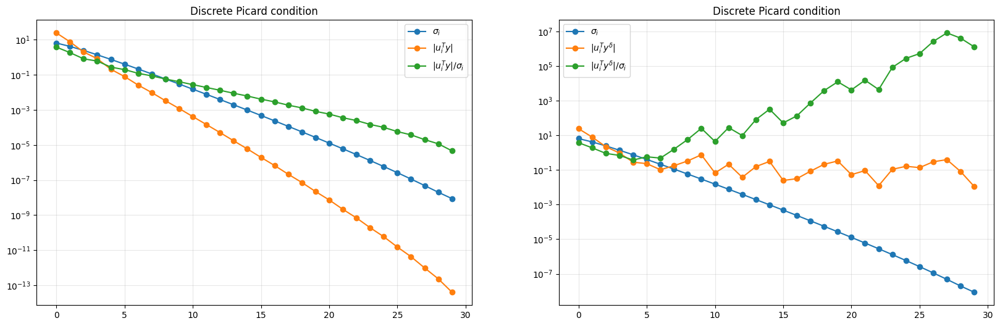

In [246]:
U, s, VT = np.linalg.svd(A, full_matrices=True)

uTy = np.abs(U.T @ y)
pic_coeff = uTy / s

plt.figure(figsize=(20, 6))

plt.subplot(1, 2, 1)
plt.semilogy(s, 'o-', label='$\sigma_i$')
plt.semilogy(uTy, 'o-', label='$|u_i^T y|$')
plt.semilogy(pic_coeff, 'o-', label='$|u_i^T y| / \sigma_i$')
plt.title('Discrete Picard condition')
plt.grid(alpha=0.3)
plt.legend()

uTy_r = np.abs(U.T @ y_delta)
pic_coeff_r = uTy_r / s

plt.subplot(1, 2, 2)
plt.semilogy(s, 'o-', label='$\sigma_i$')
plt.semilogy(uTy_r, 'o-', label='$|u_i^T y^\delta|$')
plt.semilogy(pic_coeff_r, 'o-', label='$|u_i^T y^\delta| / \sigma_i$')
plt.title('Discrete Picard condition')
plt.grid(alpha=0.3)
plt.legend()

plt.show()

La condizione discreta di Picard è soddisfatta quando i coefficienti di Fourier decrescono più velocemente dei valori singolari.

Possiamo notare che senza il rumore, i coefficienti di Fourier decrescono più velocemente dei valori singolari su tutta la lunghezza del grafico. Mentre con il rumore, a partire circa dall'indice 4, i coefficienti di Fourier iniziano a decrescere meno velocemente rispetto ai valori singolari.

##### 2. Calcolare la soluzione naive e visualizzarla

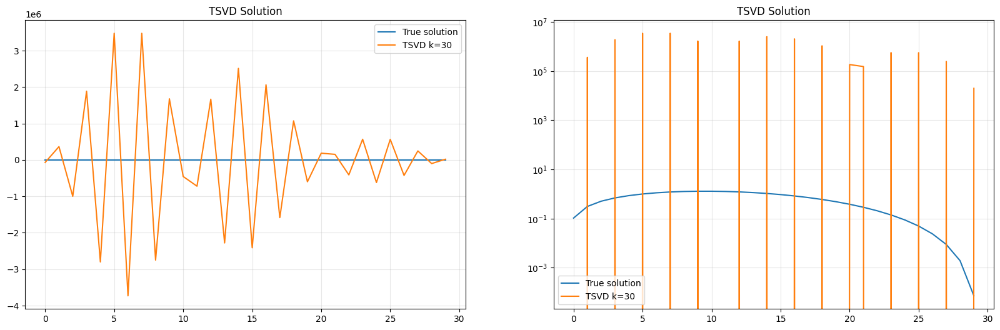

In [247]:
tsvd_solver = solvers.TSVD(A)

k = n
x_tsvd = tsvd_solver.solve(y_delta, k)

plt.figure(figsize=(20, 6))

plt.subplot(1, 2, 1)
plt.plot(x, label='True solution')
plt.plot(x_tsvd, label=f'TSVD k={k}')
plt.title('TSVD Solution')
plt.grid(alpha=0.3)
plt.legend()

plt.subplot(1, 2, 2)
plt.semilogy(x, label='True solution')
plt.semilogy(x_tsvd, label=f'TSVD k={k}')
plt.title('TSVD Solution')
plt.grid(alpha=0.3)
plt.legend()

plt.show()

Le oscillazioni che vediano ci sono a causa della presenza di errori. Il comportamento non deriva dall'algoritmo ma dai dati del problema, cioè dalla malposizione della matrice $A$.

Per ovviare questa situazione dobbiamo modificare il problema da risolvere, questo viene fatto attraverso tecniche dette metodi di regolarizzazione.

##### 3. Calcolare la soluzione regolarizzata con TSVD e visualizzarla. Scegliere il parametro utilizzando le condizioni di Picard.

Abbiamo visto in precedenza che dopo l'indice 4 le condizioni di Picard non sono più soddisfatte quindi impostiamo $k=4$. 

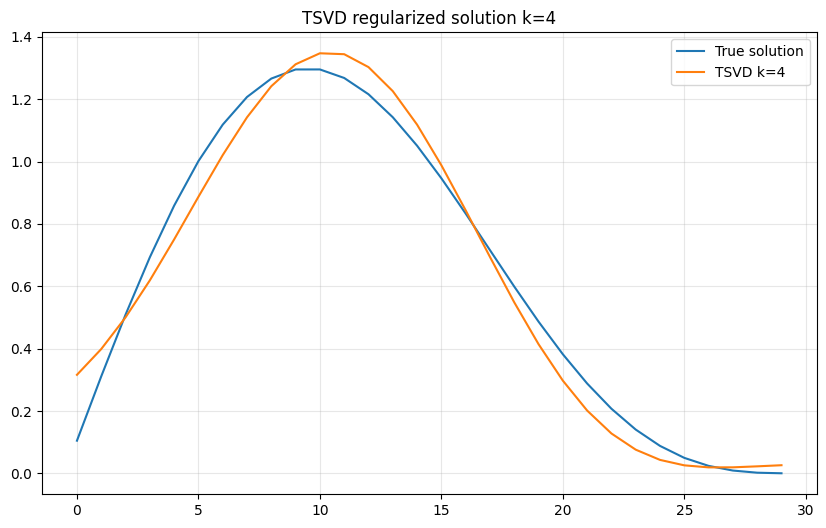

In [248]:
k: int = 4
x_tsvd = tsvd_solver.solve(y_delta, k)

plt.figure(figsize=(10, 6))
plt.plot(x, label='True solution')
plt.plot(x_tsvd, label='TSVD k=4')
plt.title('TSVD regularized solution k=4')
plt.grid(alpha=0.3)
plt.legend()
plt.show()

Per sicurezza proviamo a visualizzare la funzione con $k=3$ e $k=5$.

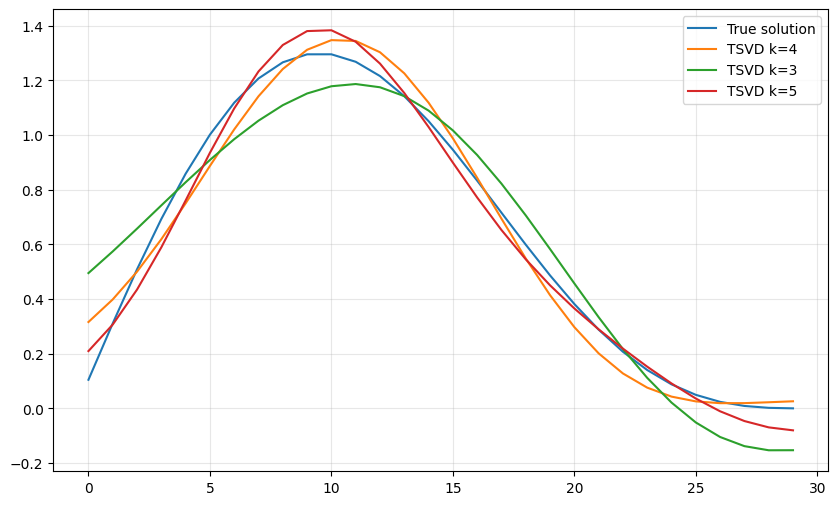

In [250]:
x_tsvd_k3 = tsvd_solver.solve(y_delta, k=3)
x_tsvd_k5 = tsvd_solver.solve(y_delta, k=5)

plt.figure(figsize=(10, 6))
plt.plot(x, label='True solution')
plt.plot(x_tsvd, label='TSVD k=4')
plt.plot(x_tsvd_k3, label='TSVD k=3')
plt.plot(x_tsvd_k5, label='TSVD k=5')
plt.grid(alpha=0.3)
plt.legend()
plt.show()

Ad occhio la soluzione che si avvicina di più alla ground truth è effettivamente $k=4$.

##### 4. Calcolare la soluzione regolarizzata con Tikhonov e visualizzarla. Scegliere il parametro utilizzando il principio di massima Discrepanza e utilizzando un metodo euristico trial and error. Quali considerazioni posso fare?

La regolarizzazione di Tikhonov è un'alternativa più efficiente che usa fattori di filtro in $[0, 1]$, pesa quindi le componenti della somma in modo più graduale. Per scegliere il parametro più adatto utilizziamo:
* Il principio della massima discrepanza (DS)
* Trial and error

Scelgo dei $\lambda \in [10^{-8}, 10^1]$ con 20 punti in scala logaritmica, risolvo con Tikhonov e allo stesso tempo calcolo i residui.

In [251]:
tik_solver = solvers.Tikhonov(A)

lambdas = np.logspace(-8, 1, 20)
residuals = []
solutions = []

for lmbda in lambdas:
    x_tik = tik_solver.solve(y_delta, lmbda=lmbda)
    residual = np.linalg.norm(A @ x_tik - y_delta)
    residuals.append(residual)
    solutions.append(x_tik)

Per applicare il principio della massima discrepanza (DS) e scegliere il parametro, dobbiamo trovare il $\lambda$ che più si avvicina a questa relazione:
$$\|Ax_{\lambda}-y^\delta\|= \tau\delta$$

Quindi la norma del residuo deve essere uguale alla discrepanza sui dati.

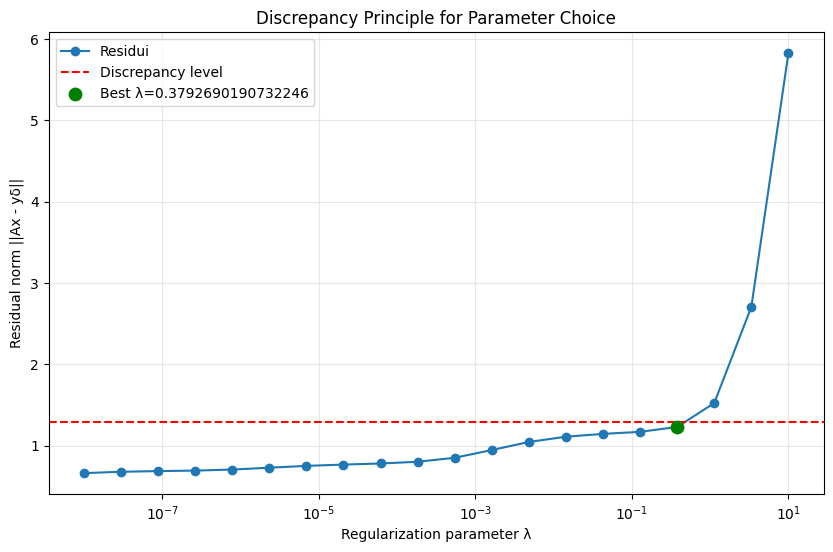

In [252]:
tau = 1.01
discrepancy_level = tau * noise_level * np.linalg.norm(y)

best_i = np.argmin([abs(res - discrepancy_level) for res in residuals])

best_lambda = lambdas[best_i]
best_solution = solutions[best_i]

plt.figure(figsize=(10, 6))
plt.semilogx(lambdas, residuals, marker='o', label="Residui")
plt.axhline(discrepancy_level, color='r', linestyle='--', label='Discrepancy level')
plt.scatter(best_lambda, residuals[best_i], color='g', s=80, zorder=5, label=f'Best λ={best_lambda}')
plt.xlabel('Regularization parameter λ')
plt.ylabel('Residual norm ||Ax - yδ||')
plt.title('Discrepancy Principle for Parameter Choice')
plt.grid(alpha=0.3)
plt.legend()
plt.show()

Procediamo successivamente alla scelta del $\lambda$ con il metodo trial and error e osserviamo quale si avvicina di più al ground truth.

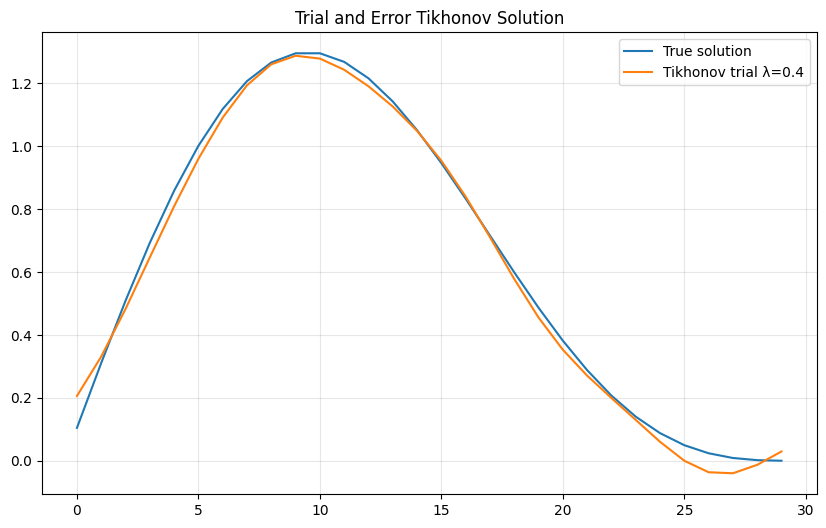

In [262]:
trial_lambda = 0.4
trial_solution = tik_solver.solve(y_delta, lmbda=trial_lambda)

plt.figure(figsize=(10, 6))
plt.plot(x, label='True solution')
plt.plot(trial_solution, label=f'Tikhonov trial λ={trial_lambda}')
plt.title("Trial and Error Tikhonov Solution")
plt.grid(alpha=0.3)
plt.legend()
plt.show()

Dopo varie prove, che non sono state riportate in quanto fuorvianti, il parametro che visivamente sembra avvicinarsi di più alla ground truth è $\lambda=0.4$.

Di seguito visualizziamo il grafico con le soluzioni trovate con il principio della massima discrepanza e il trial and error.

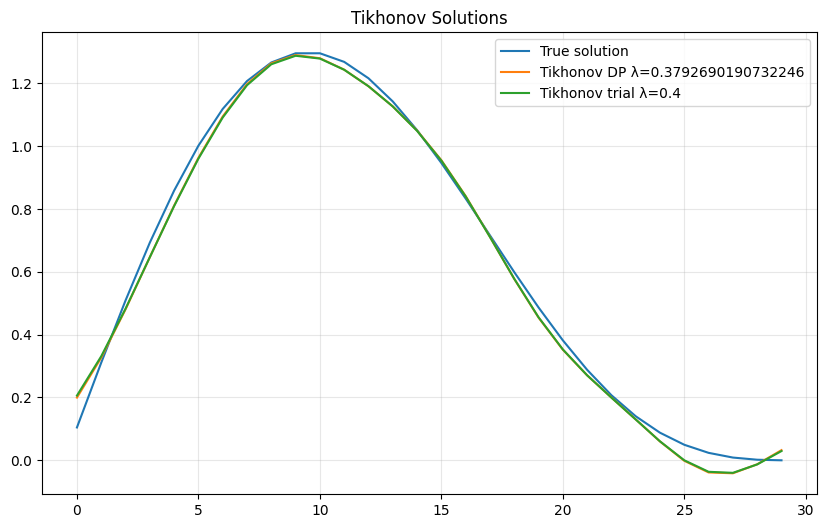

In [263]:
plt.figure(figsize=(10, 6))
plt.plot(x, label='True solution')
plt.plot(best_solution, label=f'Tikhonov DP λ={best_lambda}')
plt.plot(trial_solution, label=f'Tikhonov trial λ={trial_lambda}')
plt.title("Tikhonov Solutions")
plt.grid(alpha=0.3)
plt.legend()

plt.show()

Il valore trovato con il principio di discrepanza è $\lambda=0.379$ mentre quello trovato con il trial and error è $\lambda=0.4$.

Il principio di discrepanza fornisce una scelta oggettiva e giustificata teoricamente. Invece, il trial and error, pur essendo soggettivo, può portare anch'essa a un risultato soddisfacente. Nel nostro caso i risultati trovati sono molto simili.

##### Ripeto i punti precedenti variando il livello di rumore, rispettivamente [0, 0.01, 0.1].

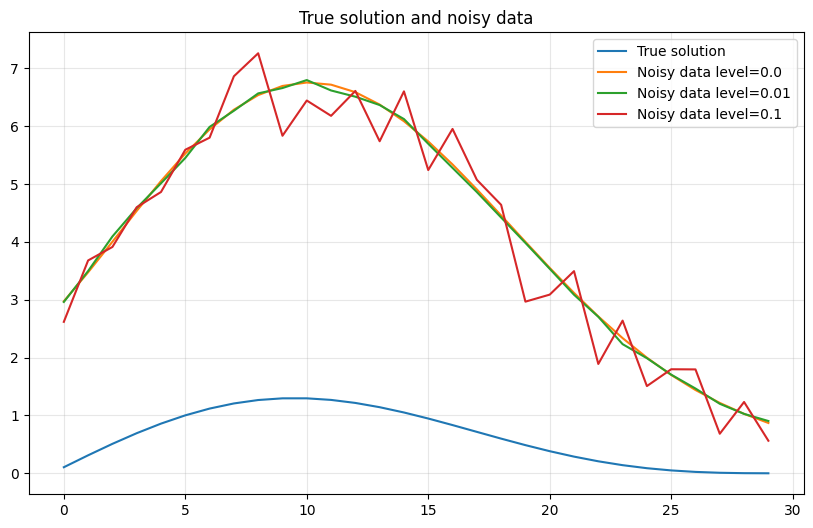

In [264]:
noise_levels = [0.0, 0.01, 0.1]
y_deltas = []

plt.figure(figsize=(10, 6))
plt.plot(x, label='True solution')

for noise_level in noise_levels:
    y_delta = y + utilities.gaussian_noise(y, noise_level)
    y_deltas.append(y_delta)
    plt.plot(y_delta, label=f'Noisy data level={noise_level}')

plt.title('True solution and noisy data')
plt.grid(alpha=0.3)
plt.legend()
plt.show()

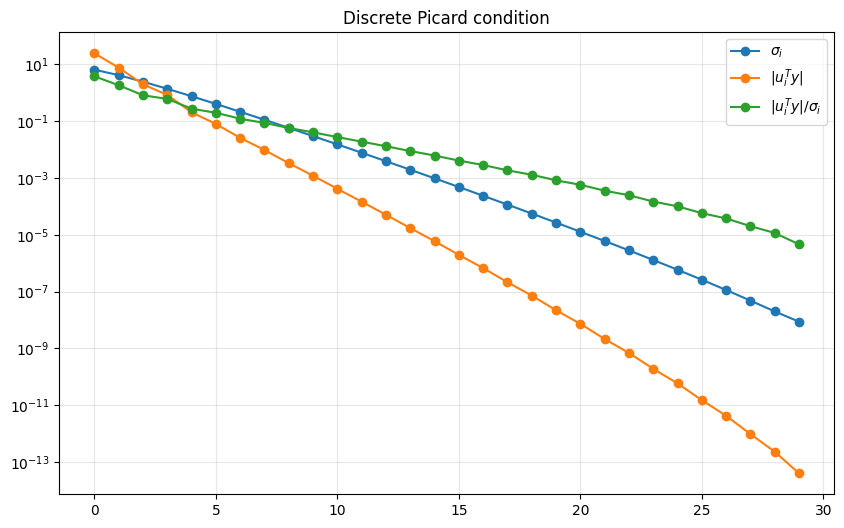

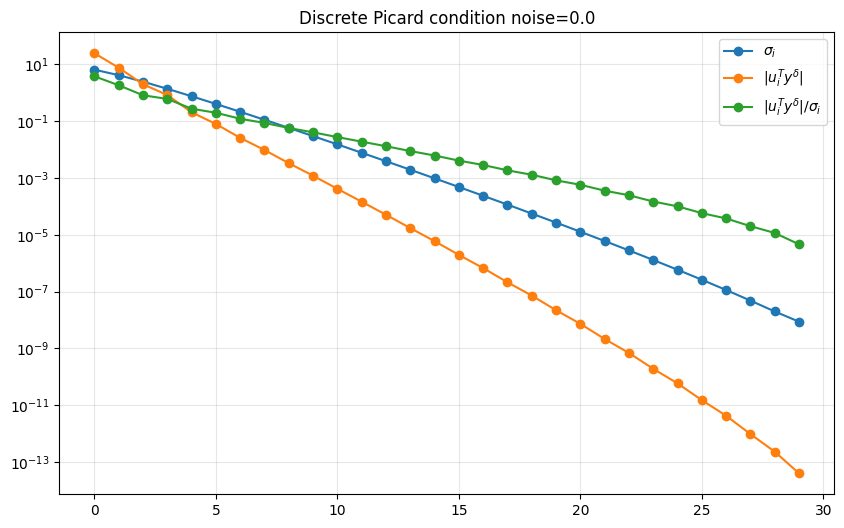

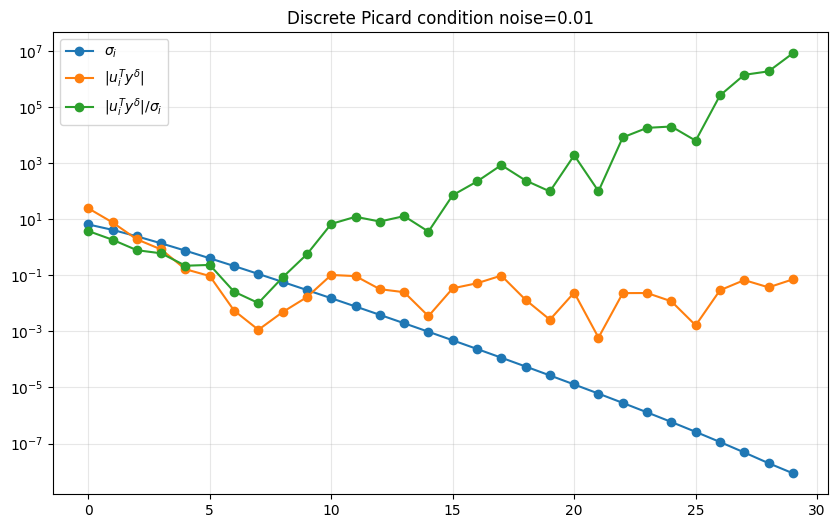

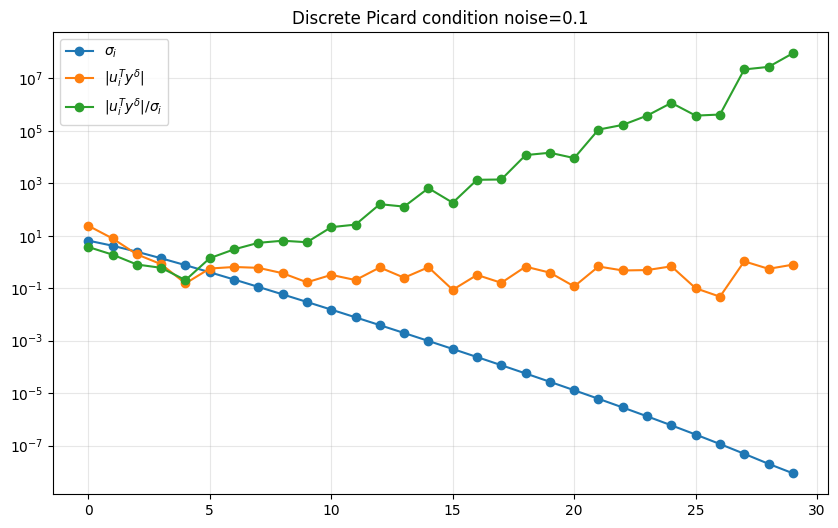

In [266]:
U, s, VT = np.linalg.svd(A, full_matrices=True)

uTy = np.abs(U.T @ y)
pic_coeff = uTy / s
plt.figure(figsize=(10, 6))
plt.semilogy(s, 'o-', label='$\sigma_i$')
plt.semilogy(uTy, 'o-', label='$|u_i^T y|$')
plt.semilogy(pic_coeff, 'o-', label='$|u_i^T y| / \sigma_i$')
plt.title(f'Discrete Picard condition')
plt.grid(alpha=0.3)
plt.legend()
plt.show()

for noise_level, y_delta in zip(noise_levels, y_deltas):
    uTy_r = np.abs(U.T @ y_delta)
    pic_coeff_r = uTy_r / s

    plt.figure(figsize=(10, 6))
    plt.semilogy(s, 'o-', label='$\sigma_i$')
    plt.semilogy(uTy_r, 'o-', label='$|u_i^T y^\delta|$')
    plt.semilogy(pic_coeff_r, 'o-', label='$|u_i^T y^\delta| / \sigma_i$')
    plt.title(f'Discrete Picard condition noise={noise_level}')
    plt.grid(alpha=0.3)
    plt.legend()
    plt.show()

noise level $\rightarrow$ indice dove i parametri Fourier non decrescono più velocemente:
* 0.0 $\rightarrow$ /
* 0.01 $\rightarrow$ 7
* 0.1 $\rightarrow$ 4

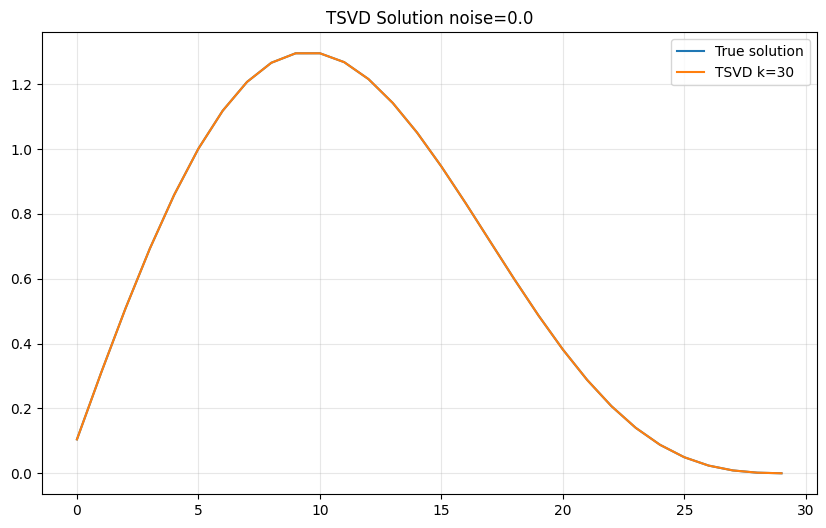

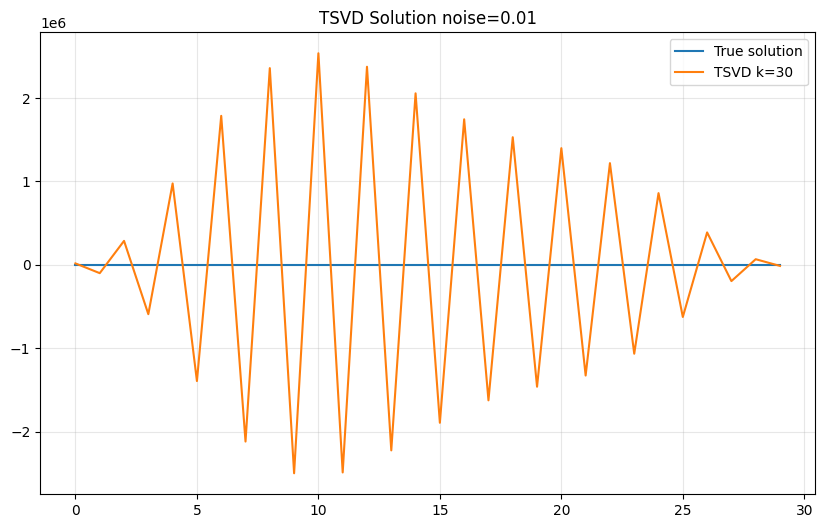

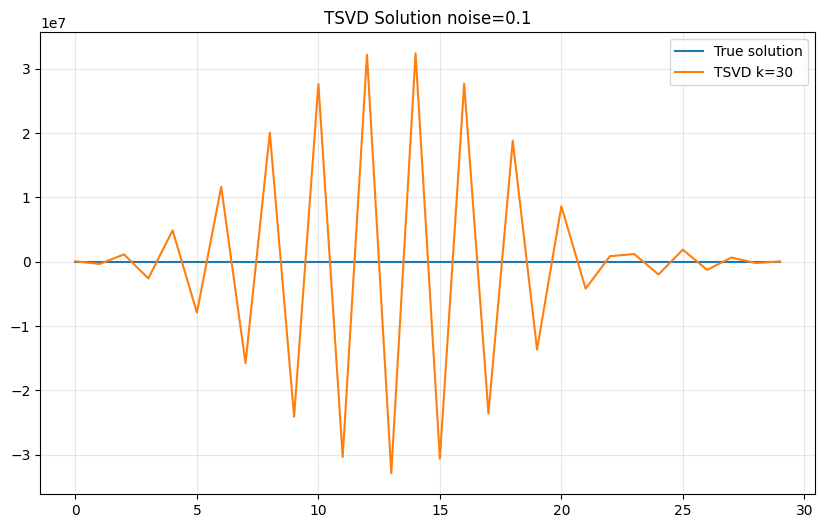

In [268]:
k=n

for noise_level, y_delta in zip(noise_levels, y_deltas):
    x_tsvd = tsvd_solver.solve(y_delta, k)

    plt.figure(figsize=(10, 6))
    plt.plot(x, label='True solution')
    plt.plot(x_tsvd, label=f'TSVD k={k}')
    plt.title(f'TSVD Solution noise={noise_level}') 
    plt.grid(alpha=0.3)
    plt.legend()
    plt.show()

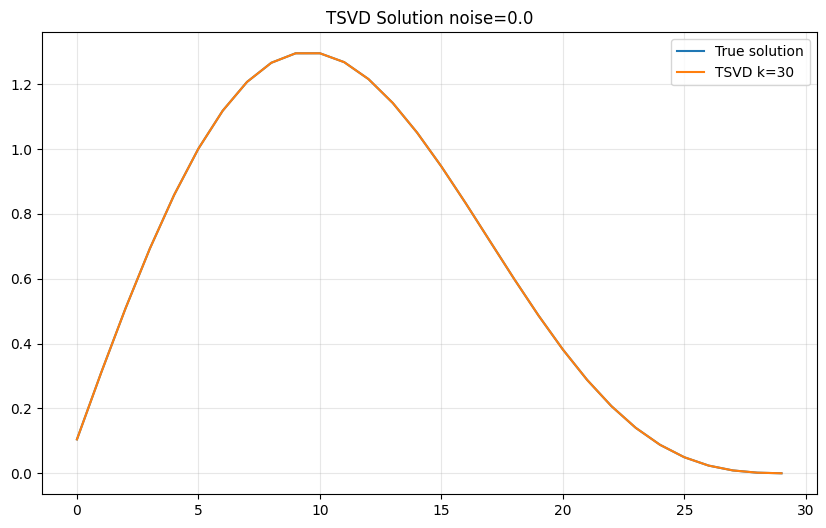

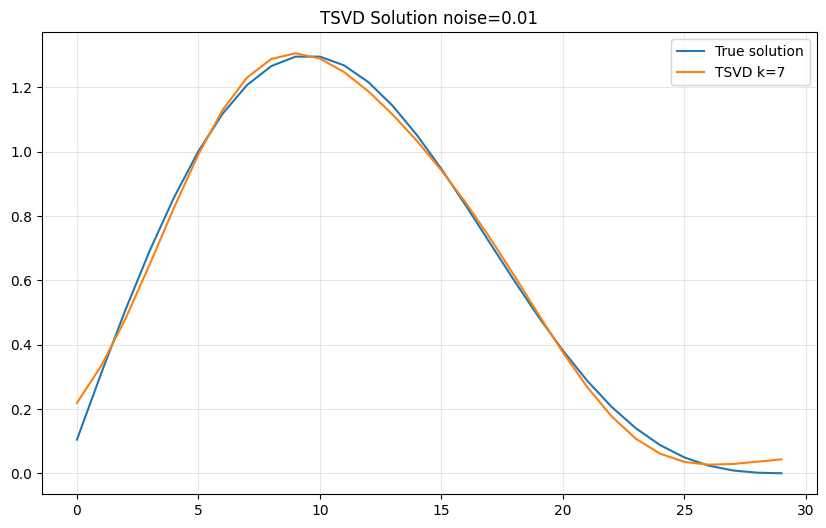

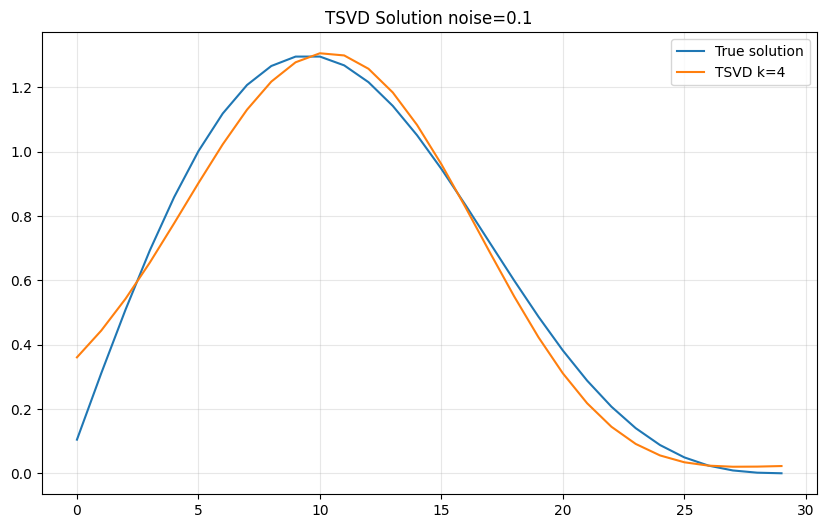

In [269]:
ks: list = [n, 7, 4]

for noise_level, y_delta, k in zip(noise_levels, y_deltas, ks):
    x_tsvd = tsvd_solver.solve(y_delta, k)

    plt.figure(figsize=(10, 6))
    plt.plot(x, label='True solution')
    plt.plot(x_tsvd, label=f'TSVD k={k}')
    plt.title(f'TSVD Solution noise={noise_level}') 
    plt.grid(alpha=0.3)
    plt.legend()
    plt.show()

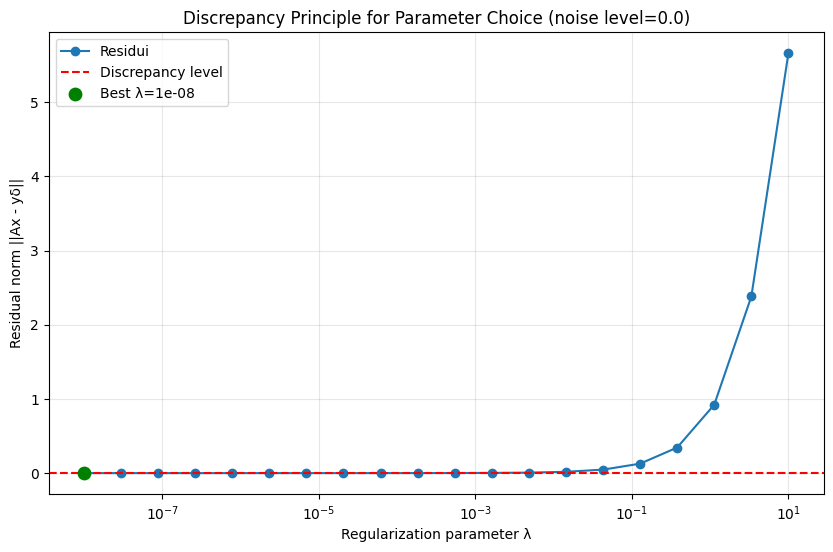

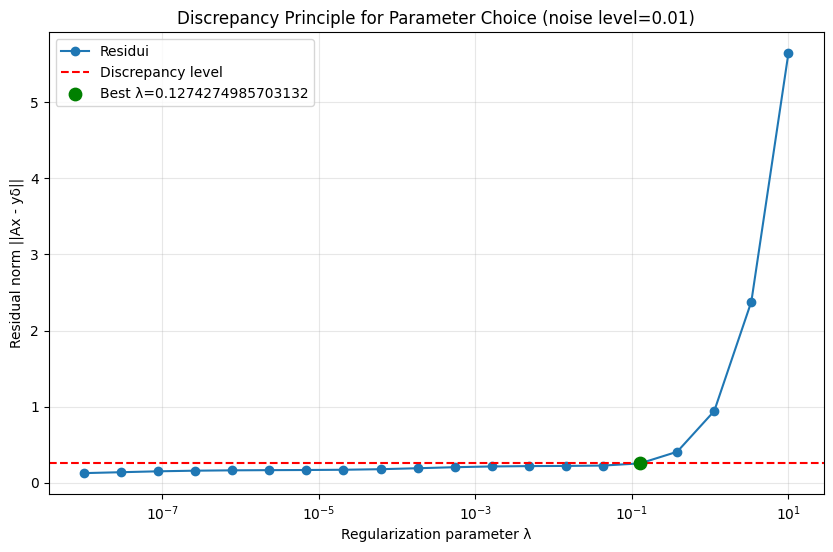

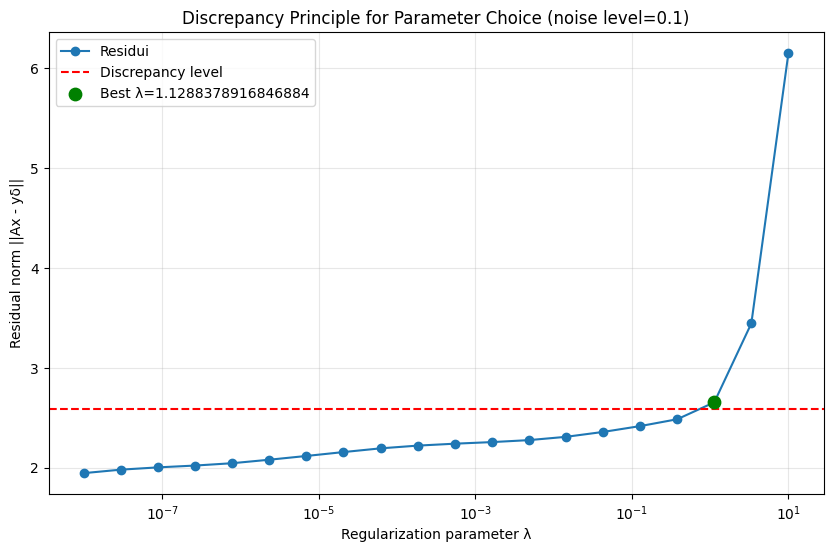

In [296]:
best_lambdas: list = []
best_solutions: list = []

for noise_level, y_delta in zip(noise_levels, y_deltas):
    residuals = []
    solutions = []

    for lmbda in lambdas:
        x_tik = tik_solver.solve(y_delta, lmbda=lmbda)
        residual = np.linalg.norm(A @ x_tik - y_delta)
        residuals.append(residual)
        solutions.append(x_tik)
        
    discrepancy_level = tau * noise_level * np.linalg.norm(y)
    
    best_i = np.argmin([abs(res - discrepancy_level) for res in residuals])
    
    best_lambda = lambdas[best_i]
    best_solution = solutions[best_i]
    best_lambdas.append(best_lambda)
    best_solutions.append(best_solution)
    
    plt.figure(figsize=(10, 6))
    plt.semilogx(lambdas, residuals, marker='o', label="Residui")
    plt.axhline(discrepancy_level, color='r', linestyle='--', label='Discrepancy level')
    plt.scatter(best_lambda, residuals[best_i], color='g', s=80, zorder=5, label=f'Best λ={best_lambda}')
    plt.xlabel('Regularization parameter λ')
    plt.ylabel('Residual norm ||Ax - yδ||')
    plt.title(f'Discrepancy Principle for Parameter Choice (noise level={noise_level})')
    plt.grid(alpha=0.3)
    plt.legend()
    plt.show()

Per il trial and error:
* rumore 0.0 $\rightarrow$ più il parametro è piccolo più si avvicina al risultato, basta che non sia 0.
* rumore 0.1 $\rightarrow$ $\lambda =0.1$
* rumore 1.5 $\rightarrow$ $\lambda =1$

Visualizziamo le soluzioni.


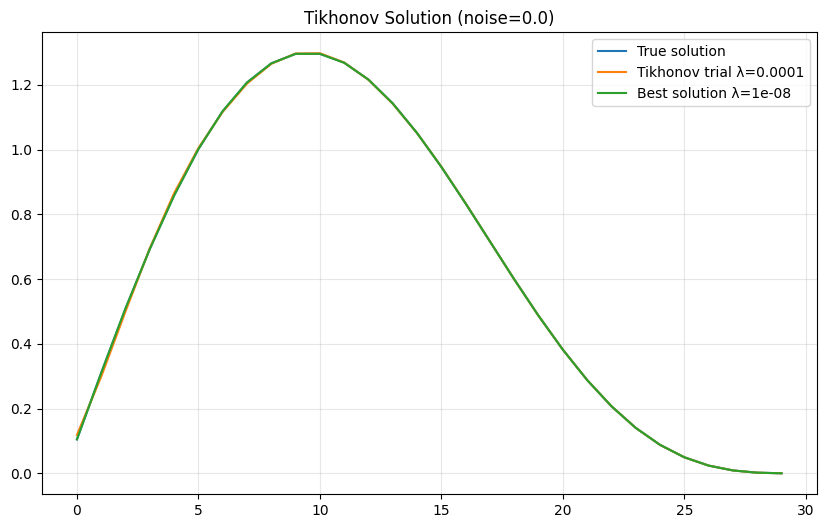

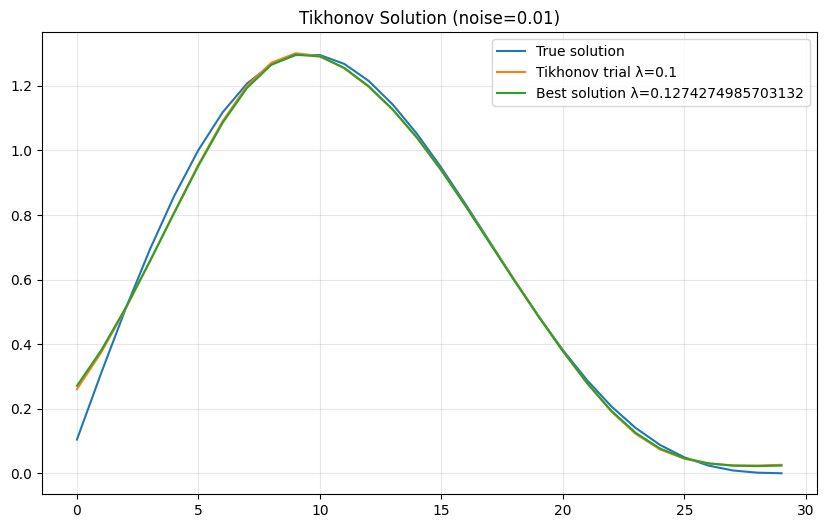

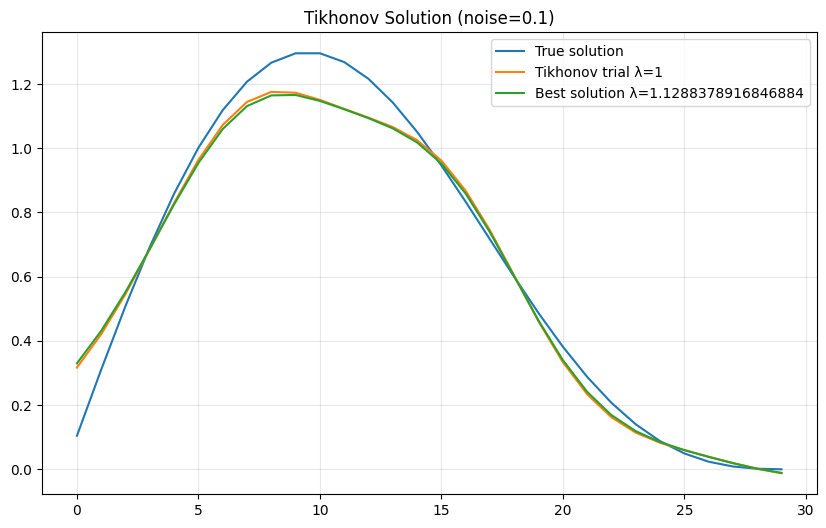

In [299]:
trial_lambdas = [0.0001, 0.1, 1]
trial_solutions = []

for noise_level, y_delta, trial_lambda in zip(noise_levels, y_deltas, trial_lambdas):
    trial_solution = tik_solver.solve(y_delta, lmbda=trial_lambda)
    trial_solutions.append(trial_solution)

for noise_level, trial_lambda, trial_solution, best_lambda, best_solution in zip(noise_levels, trial_lambdas, trial_solutions, best_lambdas, best_solutions):
    plt.figure(figsize=(10, 6))
    plt.plot(x, label='True solution')
    plt.plot(trial_solution, label=f'Tikhonov trial λ={trial_lambda}')
    plt.plot(best_solution, label=f'Best solution λ={best_lambda}')
    plt.title(f"Tikhonov Solution (noise={noise_level})")
    plt.grid(alpha=0.3)
    plt.legend()
    plt.show()

### Image deblur

Scegliere una immagine a piacere (no cameraman!!!) in scala di grigi ed eseguire i seguenti punti:

1. Creare un problema.

2. Calcolare la soluzione naive risolvendo il problema di minimi quadrati con CGLS.

3. Calcolare la soluzione regolarizzata con Tikhonov. Calcolare il valore di $\lambda$ sia con il principio di Massima Discrepanza che come valore che minimizza l’errore assoluto fra l’immagine ground truth e la ricostruzione (su una griglia di valori di $\lambda$), visualizzando il grafico relativo.

4. Calcolare la soluzione regolarizzata con Total Variation. Calcolare il valore di $\lambda$  come valore che minimizza l’errore assoluto (in norma 2) fra l’immagine ground truth e la ricostruzione (su una griglia di valori di $\lambda$) visualizzando il grafico relativo.

Ripetere i punti precedenti per diversi livelli di rumore (tre-quattro) nell’intervallo $[0, 0.01]$ (provare entrambi gli estremi dell’intervallo) e con due diversi valori dei parametri del nucleo gaussiano della Point Spread Function.
N.B: Controllare che i metodi iterativi di minimizzazione (CGLS e gradiente) escano per raggiunto criterio di arresto e non per numero massimo di iterazioni. In tal caso aumentare il numero massimo di iterazioni.
Riportare in un documento pdf i risultati ottenuti in termini di immagini, grafici (visualizzare per esempio il grafico dell’ errore al variare dell iterazioni nei diversi casi), tabelle con le metriche di valutazione viste a
lezione, che verrà poi eventualmente discusso durante la prova orale.

#### SOLUZIONE:

In [345]:
from ProblemiInversi import operators, solvers, utilities
import numpy as np
import matplotlib.pyplot as plt

Il problema del deblur consiste nella ricostruzione di un immagine a partire da un dato acquisito mediante il seguente modello:
$$y^\delta=Ax+w$$
dove $y^\delta$ rappresenta l'immagine corrotta, $x$ l'immagine originale che vogliamo ricostruire, $A$ la Point Spread Function e $w$ il rumore additivo con distribuzione Gaussiana. Andiamo a definire questo problema.

##### 1. Creare un problema.

Dimensioni dell'immagine: 512x512


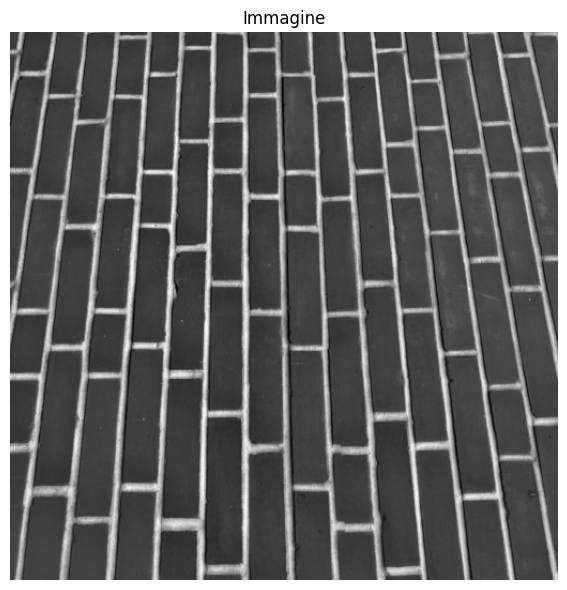

In [443]:
from skimage import data
    
x = data.brick().astype(float)
nx, ny = x.shape

x = x / x.max()

print(f"Dimensioni dell'immagine: {nx}x{ny}")

plt.figure(figsize=(6, 6))
plt.imshow(x, cmap='gray')
plt.title('Immagine')
plt.axis('off')
plt.tight_layout()
plt.show()

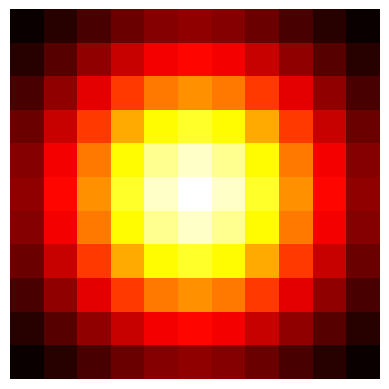

Kernel size: 11x11


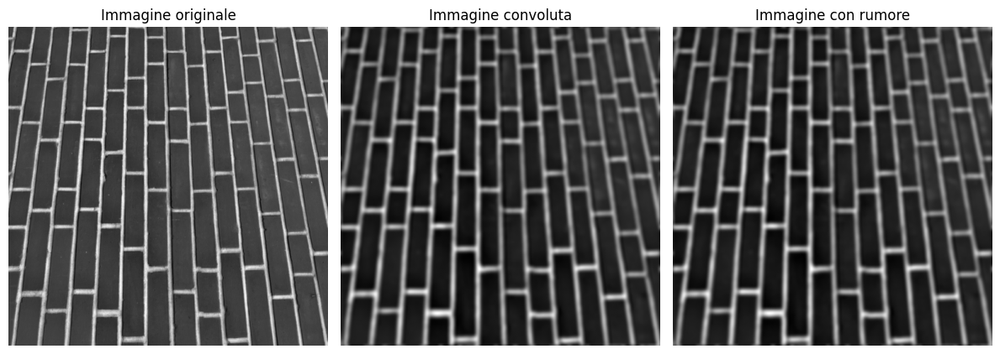

In [449]:
sigma: float = 3
k_size: int = 11
noise_level: float = 0.001

kernel = utilities.gaussian2d_kernel(k_size, sigma)
A = operators.ConvolutionOperator(kernel)

plt.imshow(kernel, cmap='hot')
plt.axis('off')
plt.show()

print(f"Kernel size: {k_size}x{k_size}")

y = A(x)
y_delta = y + utilities.gaussian_noise(y, noise_level)

plt.figure(figsize=(12, 6))
plt.subplot(1, 3, 1)
plt.imshow(x, cmap='gray')
plt.title('Immagine originale')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(y, cmap='gray')
plt.title('Immagine convoluta')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(y_delta, cmap='gray')
plt.title('Immagine con rumore')
plt.axis('off')
plt.tight_layout()

plt.show()

##### 2. Calcolare la soluzione naive risolvendo il problema di minimi quadrati con CGLS.

Dato che è richiesto che i metodi iterativi escano per criterio di arresto e non per massimo di iterazioni, ho aggiunto la seguente riga di codice sel risolutore CGLS "return x, k, ("tol" if k < kmax else "kmax")".

CGLS converge in 78 interazioni a causa di tol.


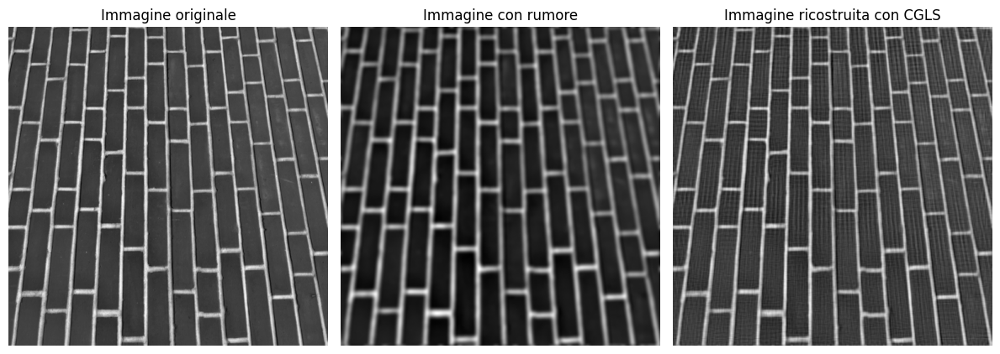

In [457]:
cgls_solver = solvers.CGLS(A)

x0 = np.zeros_like(x)
KMAX_CGLS: int = 500
TOLF: float = 1e-2
TOLX: float = 1e-2

x_cgls, k, info = cgls_solver.solve(y_delta, x0, kmax=KMAX_CGLS, tolf=TOLF, tolx=TOLX)

print(f"CGLS converge in {k} interazioni a causa di {info}.")

plt.figure(figsize=(12, 6))
plt.subplot(1, 3, 1)
plt.imshow(x, cmap='gray')
plt.title('Immagine originale')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(y_delta, cmap='gray')
plt.title('Immagine con rumore')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(x_cgls, cmap='gray')
plt.title('Immagine ricostruita con CGLS')
plt.axis('off')
plt.tight_layout()
plt.show()


Sappiamo quindi che utilizzando il metodo naive con cgls e fissando la tolleranza a 1e-2, l'algoritmo si converge in 78 iterazioni.

Utilizziamo delle metriche di valutazione per avere un feedback oggettivo sul risultato ottenuto:
* L'errore relativo (ER)
* Peak to Signal Noise Ratio (PSNR)
* Structural Similarity Index (SSIM)

In [459]:
cgls_ER = utilities.rel_err(x_cgls, x)
cgls_PSNR = utilities.psnr(x_cgls, x)
cgls_SSIM = utilities.ssim(x_cgls, x)

print('ER', cgls_ER)
print('PSNR', cgls_PSNR)
print('SSIM', cgls_SSIM)

ER 0.04157980298021016
PSNR 32.7687197633097
SSIM 0.7530162050428117


* ER 0.0416 $\rightarrow$ significa che la ricostruzione differisce dall'originale del 4% in norma relativa.
* PSNR 32.7687 $\rightarrow$ più il valore è alto migliore la qualità, il valore è buono.
* SSIM 0.7530 $\rightarrow$ è la più fedele rispetto alla qualità visiva dell'immagine ed ha valori in [0, 1], più è vicino a uno migliore è la qualità dell'immagine.

##### 3. Calcolare la soluzione regolarizzata con Tikhonov. Calcolare il valore di $\lambda$ sia con il principio di Massima Discrepanza che come valore che minimizza l’errore assoluto fra l’immagine ground truth e la ricostruzione (su una griglia di valori di $\lambda$), visualizzando il grafico relativo.

In [484]:
L = operators.Identity()
lambdas = np.logspace(-6, 1, 10)

KMAX_TIK: int = 500
pad: int = 512
ybar = np.pad(y, ((0, pad), (0, 0)))
ybar_delta = np.pad(y_delta, ((0, pad), (0, 0)))
x0 = np.zeros_like(x)

x_tiks = []
errors_tik = []
psnrs_tik = []
ssims_tik = []
residuals = []

for lmbda in lambdas:
    M = operators.TikhonovOperator(A, L, lmbda)
    clgs_tik_solver = solvers.CGLS(M)
    x_tik, k, info = clgs_tik_solver.solve(ybar_delta, x0, kmax=KMAX_TIK, tolf=TOLF, tolx=TOLX)
    x_tiks.append(x_tik)
    
    print(f"Tikhonov λ={lmbda} converge in {k} iterazioni a causa di {info}.")
    
    err = utilities.rel_err(x_tik, x)
    psnr = utilities.psnr(x_tik, x)
    ssim = utilities.ssim(x_tik, x)
    errors_tik.append(err)
    psnrs_tik.append(psnr)
    ssims_tik.append(ssim)

    res = np.linalg.norm(A @ x_tik - y_delta)
    residuals.append(res)

Tikhonov λ=1e-06 converge in 78 iterazioni a causa di tol.
Tikhonov λ=5.994842503189409e-06 converge in 78 iterazioni a causa di tol.
Tikhonov λ=3.5938136638046256e-05 converge in 78 iterazioni a causa di tol.
Tikhonov λ=0.00021544346900318845 converge in 78 iterazioni a causa di tol.
Tikhonov λ=0.001291549665014884 converge in 78 iterazioni a causa di tol.
Tikhonov λ=0.007742636826811269 converge in 69 iterazioni a causa di tol.
Tikhonov λ=0.04641588833612782 converge in 38 iterazioni a causa di tol.
Tikhonov λ=0.2782559402207126 converge in 12 iterazioni a causa di tol.
Tikhonov λ=1.668100537200059 converge in 4 iterazioni a causa di tol.
Tikhonov λ=10.0 converge in 2 iterazioni a causa di tol.


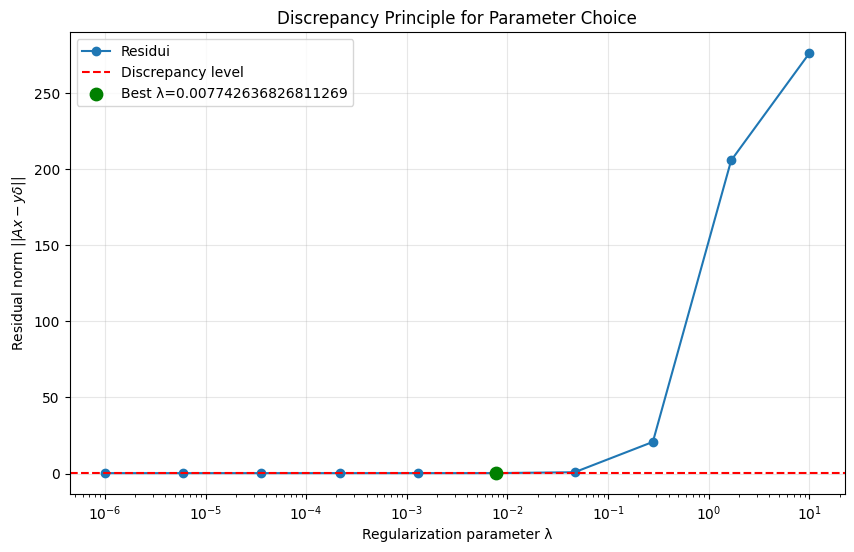

Miglior λ per discrepanza: 0.007743


In [485]:
tau = 1.01
discrepancy_level = tau * noise_level * np.linalg.norm(y)
best_i = np.argmin([abs(res - discrepancy_level) for res in residuals])
best_lambda = lambdas[best_i]
best_solution = x_tiks[best_i]

plt.figure(figsize=(10, 6))
plt.semilogx(lambdas, residuals, marker='o', label="Residui")
plt.axhline(discrepancy_level, color='r', linestyle='--', label='Discrepancy level')
plt.scatter(best_lambda, residuals[best_i], color='g', s=80, zorder=5, label=f'Best λ={best_lambda}')
plt.xlabel('Regularization parameter λ')
plt.ylabel('Residual norm $||Ax - y\delta||$')
plt.title('Discrepancy Principle for Parameter Choice')
plt.grid(alpha=0.3)
plt.legend()
plt.show()

print(f"Miglior λ per discrepanza: {best_lambda:.4g}")

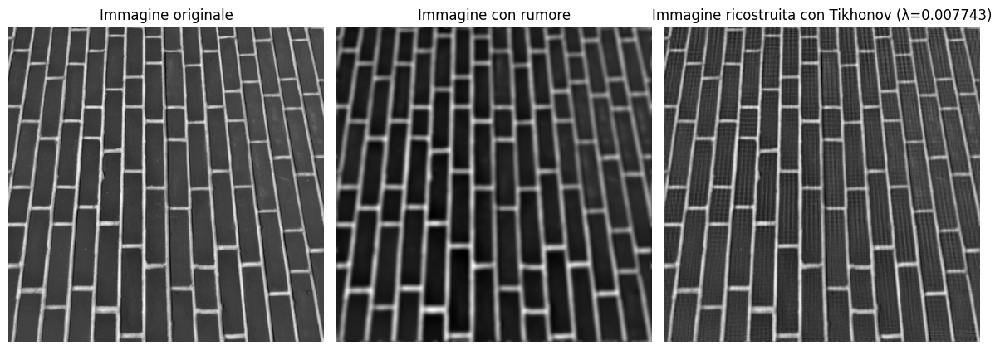

ER 0.04318523652910561
PSNR 32.439662254363654
SSIM 0.7523659344164564


In [486]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 3, 1)
plt.imshow(x, cmap='gray')
plt.title('Immagine originale')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(y_delta, cmap='gray')
plt.title('Immagine con rumore')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(best_solution, cmap='gray')
plt.title(f'Immagine ricostruita con Tikhonov (λ={best_lambda:.4g})')
plt.axis('off')
plt.tight_layout()
plt.show()

print('ER', errors_tik[best_i])
print('PSNR', psnrs_tik[best_i])
print('SSIM', ssims_tik[best_i])

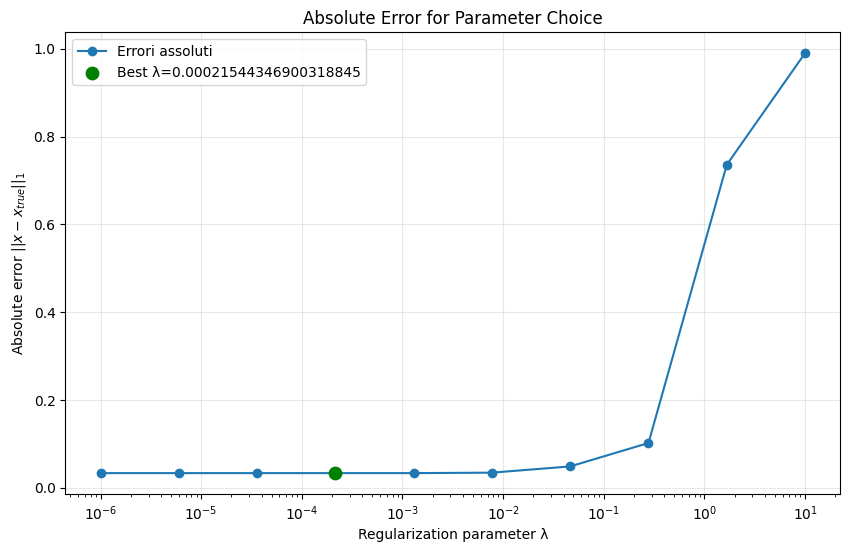

Miglior λ per errore assoluto: 0.0002154


In [487]:
absolute_errors = []

for x_tik in x_tiks:
    abs_err = np.sum(np.abs(x_tik - x)) / np.sum(np.abs(x))
    absolute_errors.append(abs_err)

abs_best_i = np.argmin(absolute_errors)
abs_best_lambda = lambdas[abs_best_i]
abs_best_solution = x_tiks[abs_best_i]

plt.figure(figsize=(10, 6))
plt.semilogx(lambdas, absolute_errors, marker='o', label="Errori assoluti")
plt.scatter(abs_best_lambda, absolute_errors[abs_best_i], color='g', s=80, zorder=5, label=f'Best λ={abs_best_lambda}')
plt.xlabel('Regularization parameter λ')
plt.ylabel('Absolute error $||x - x_{true}||_1$')
plt.title('Absolute Error for Parameter Choice')
plt.grid(alpha=0.3)
plt.legend()
plt.show()

print(f"Miglior λ per errore assoluto: {abs_best_lambda:.4g}")

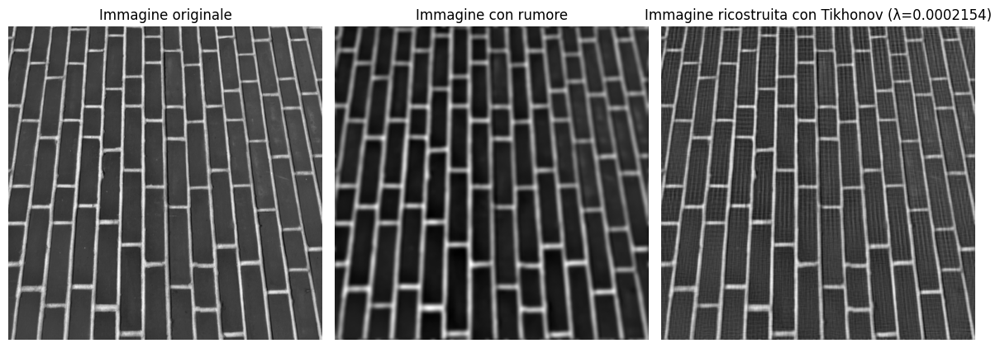

ER 0.041579956652610835
PSNR 32.76868766168943
SSIM 0.7530201047411841


In [488]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 3, 1)
plt.imshow(x, cmap='gray')
plt.title('Immagine originale')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(y_delta, cmap='gray')
plt.title('Immagine con rumore')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(abs_best_solution, cmap='gray')
plt.title(f'Immagine ricostruita con Tikhonov (λ={abs_best_lambda:.4g})')
plt.axis('off')

plt.tight_layout()
plt.show()

print('ER', errors_tik[abs_best_i])
print('PSNR', psnrs_tik[abs_best_i])
print('SSIM', ssims_tik[abs_best_i])

##### 4. Calcolare la soluzione regolarizzata con Total Variation. Calcolare il valore di $\lambda$  come valore che minimizza l’errore assoluto (in norma 2) fra l’immagine ground truth e la ricostruzione (su una griglia di valori di $\lambda$) visualizzando il grafico relativo.

Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.


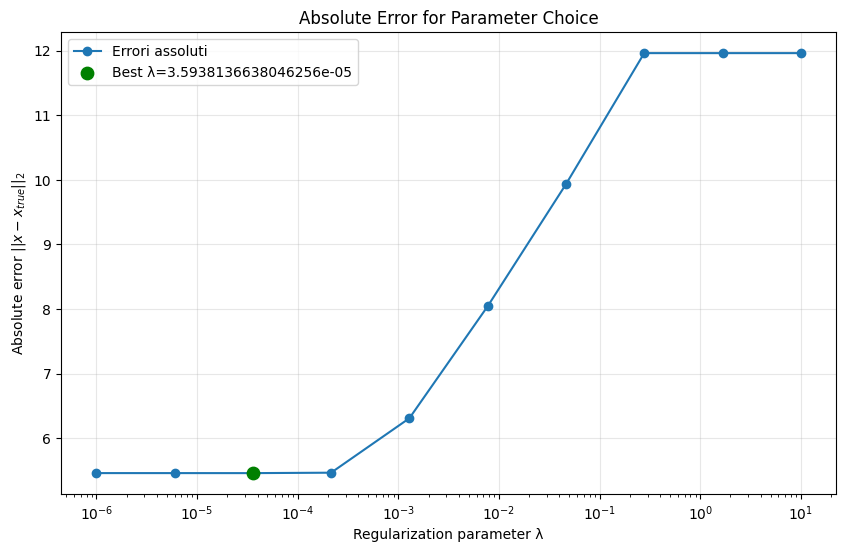

Miglior λ per errore assoluto con TV: 3.594e-05


In [489]:
beta: float = 1e-3

gd_tv_solver = solvers.GDTotalVariation(A, beta=beta)

KMAX_TV: int = 100

absolute_errors = []
solutions_tv = []
errors_tv = []
psnrs_tv = []
ssims_tv = []

for lmbda in lambdas:
    x_tv, obj_val, grad_norm = gd_tv_solver.solve(y_delta, lmbda, x0, kmax=KMAX_TV, tolf=TOLF, tolx=TOLX)
    abs_err = np.linalg.norm(x_tv - x, 2)
    absolute_errors.append(abs_err)
    solutions_tv.append(x_tv)
    
    err = utilities.rel_err(x_tv, x)
    psnr = utilities.psnr(x_tv, x)
    ssim = utilities.ssim(x_tv, x)
    errors_tv.append(err)
    psnrs_tv.append(psnr)
    ssims_tv.append(ssim)
    
abs_best_i = np.argmin(absolute_errors)
abs_best_lambda = lambdas[abs_best_i]
best_solution = solutions_tv[abs_best_i]

plt.figure(figsize=(10, 6))
plt.semilogx(lambdas, absolute_errors, marker='o', label="Errori assoluti")
plt.scatter(abs_best_lambda, absolute_errors[abs_best_i], color='g', s=80, zorder=5, label=f'Best λ={abs_best_lambda}')
plt.xlabel('Regularization parameter λ')
plt.ylabel('Absolute error $||x - x_{true}||_2$')
plt.title('Absolute Error for Parameter Choice')
plt.grid(alpha=0.3)
plt.legend()
plt.show()

print(f"Miglior λ per errore assoluto con TV: {abs_best_lambda:.4g}")

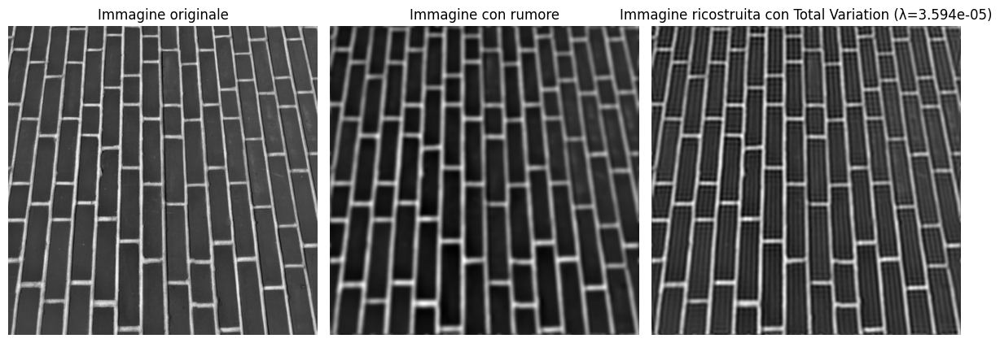

ER 0.0752529576202855
PSNR 27.61589683834826
SSIM 0.6453966356454586


In [491]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 3, 1)
plt.imshow(x, cmap='gray')
plt.title('Immagine originale')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(y_delta, cmap='gray')
plt.title('Immagine con rumore')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(best_solution, cmap='gray')
plt.title(f'Immagine ricostruita con Total Variation (λ={abs_best_lambda:.4g})')
plt.axis('off')

plt.tight_layout()
plt.show()

print('ER', errors_tv[abs_best_i])
print('PSNR', psnrs_tv[abs_best_i])
print('SSIM', ssims_tv[abs_best_i])

La soluzione di TV ha metriche peggiori perché l'immagine orriginale è un immagine con tanti dettagli fini che TV penalizzaa. Le metriche usate privilegiano l'accuratezza pixe per pixel mentre TV ottimizza la regolarità strutturale.

##### Ripeto i punti precedenti per diversi livelli di rumore [0, 0.005, 0.01], con due diversi valori dei parametri del nucleo gaussiano della Point Spread Function

Riportare in un documento pdf i risultati ottenuti in termini di immagini, grafici (visualizzare per esempio il grafico dell’ errore al variare dell iterazioni nei diversi casi), tabelle con le metriche di valutazione viste a
lezione, che verrà poi eventualmente discusso durante la prova orale.

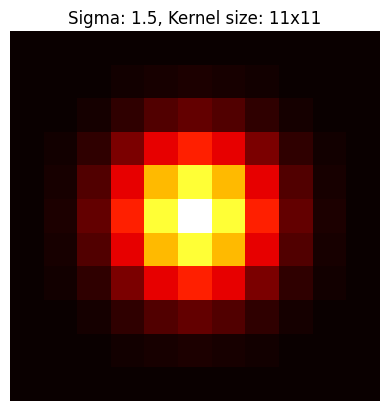

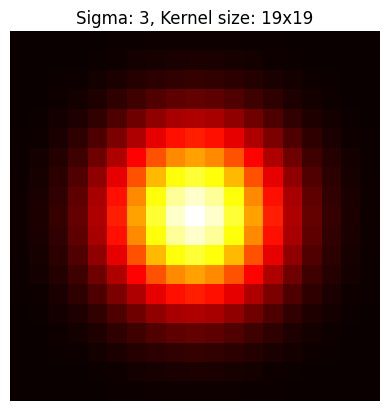

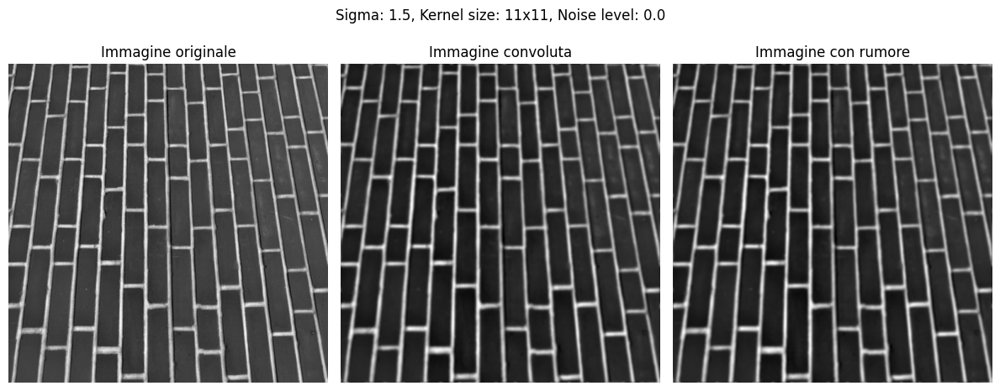

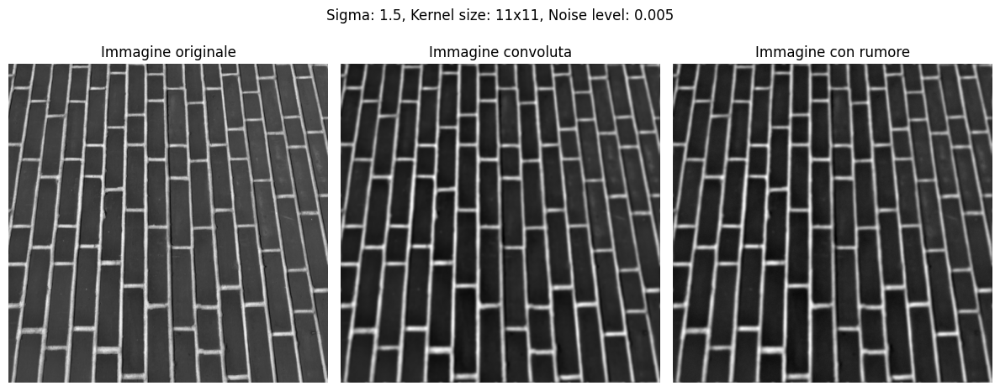

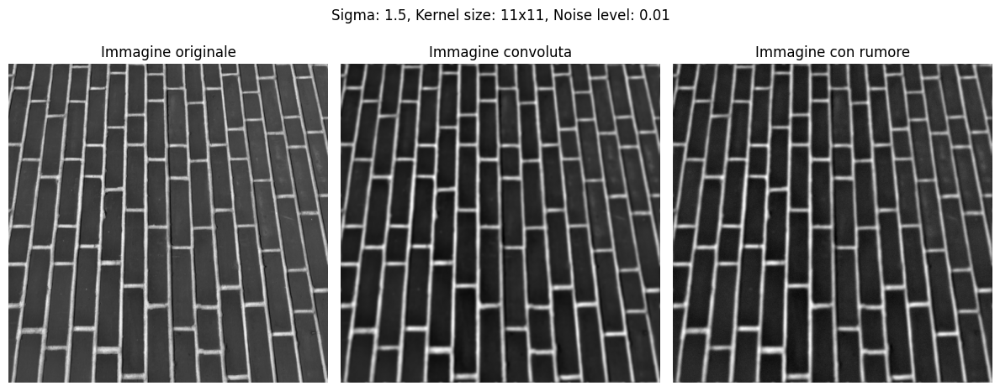

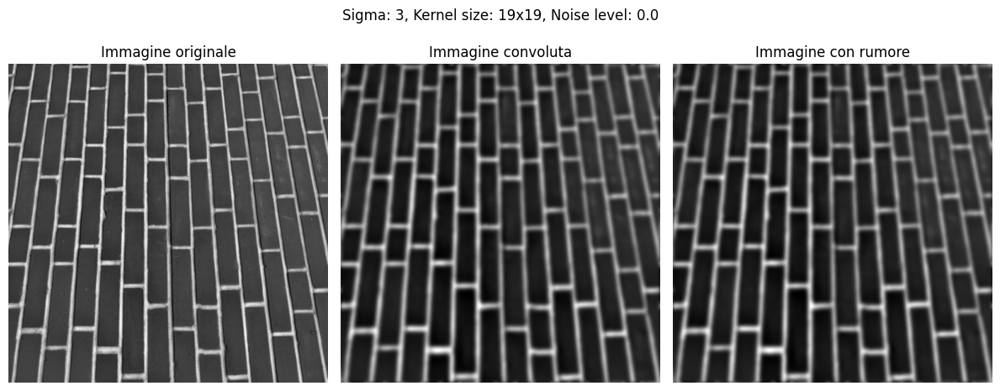

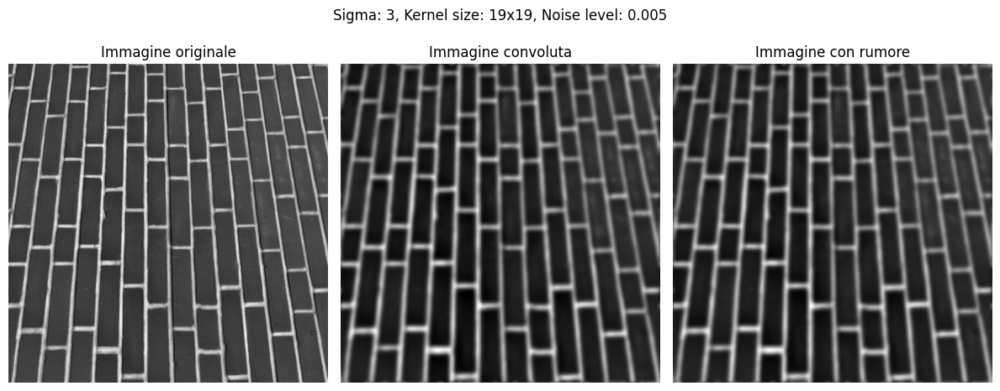

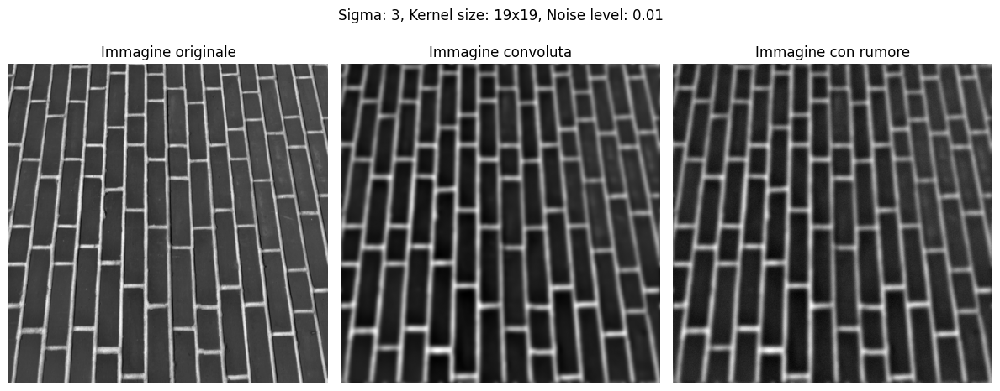

In [547]:
psf_parameters = [(1.5, 11), (3, 19)]
noise_levels: list = [0.0, 0.005, 0.01]

As = []
ys = []

for sigma, k_size in psf_parameters:
    kernel = utilities.gaussian2d_kernel(k_size, sigma)
    A = operators.ConvolutionOperator(kernel)
    As.append(A)
    y = A(x)
    ys.append(y)
    
    plt.imshow(kernel, cmap='hot')
    plt.axis('off')
    plt.title(f'Sigma: {sigma}, Kernel size: {k_size}x{k_size}')
    plt.show()
        

for (sigma, k_size), A, y in zip(psf_parameters, As, ys):
    for noise_level in noise_levels:
        y_delta = y + utilities.gaussian_noise(y, noise_level)
        
        plt.figure(figsize=(12, 5))
        plt.suptitle(f'Sigma: {sigma}, Kernel size: {k_size}x{k_size}, Noise level: {noise_level}')
        
        plt.subplot(1, 3, 1)
        plt.imshow(x, cmap='gray')
        plt.title('Immagine originale')
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(y, cmap='gray')
        plt.title('Immagine convoluta')
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(y_delta, cmap='gray')
        plt.title('Immagine con rumore')
        plt.axis('off')
        plt.tight_layout()

        plt.show()

CGLS converge in 40 interazioni a causa di tol.


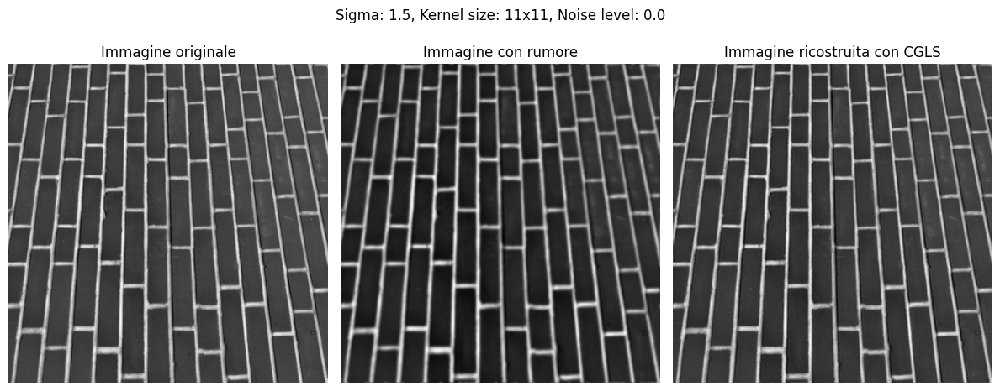

CGLS converge in 361 interazioni a causa di tol.


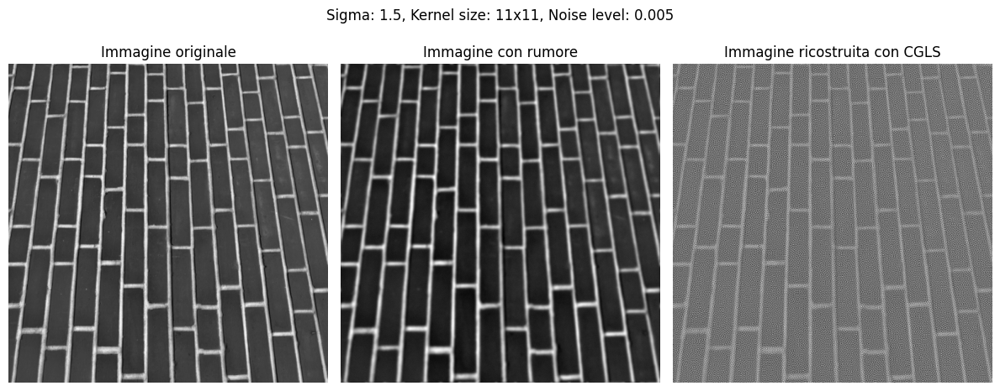

CGLS converge in 501 interazioni a causa di kmax.
CGLS converge in 1001 interazioni a causa di kmax.
CGLS converge in 1440 interazioni a causa di tol.


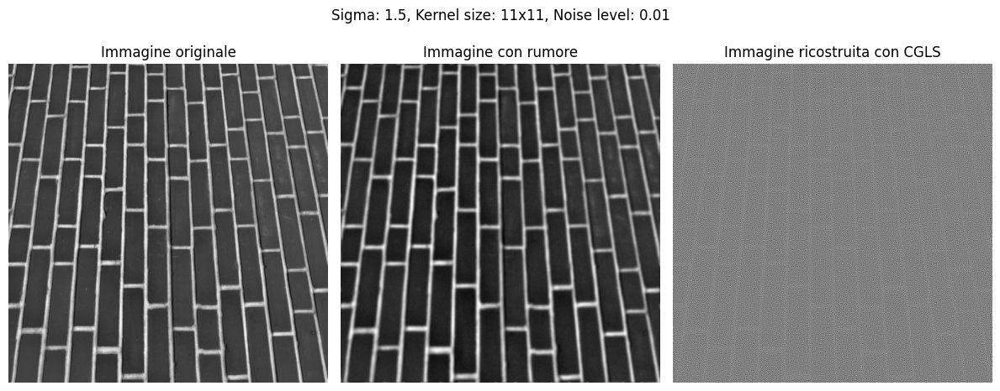

CGLS converge in 67 interazioni a causa di tol.


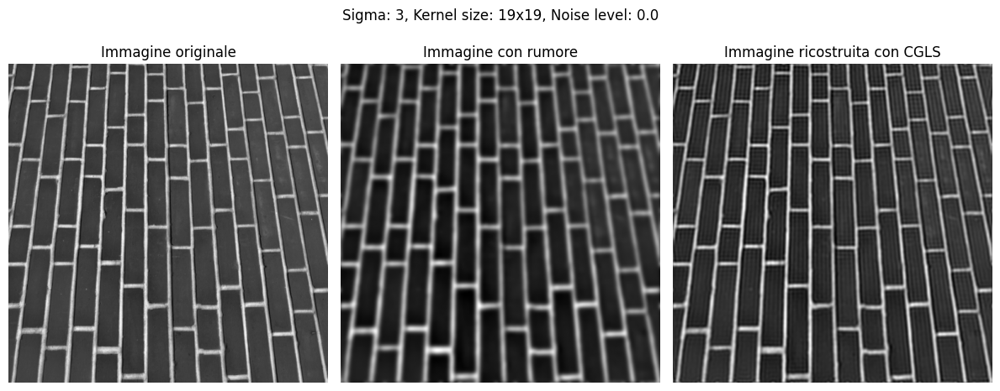

CGLS converge in 107 interazioni a causa di tol.


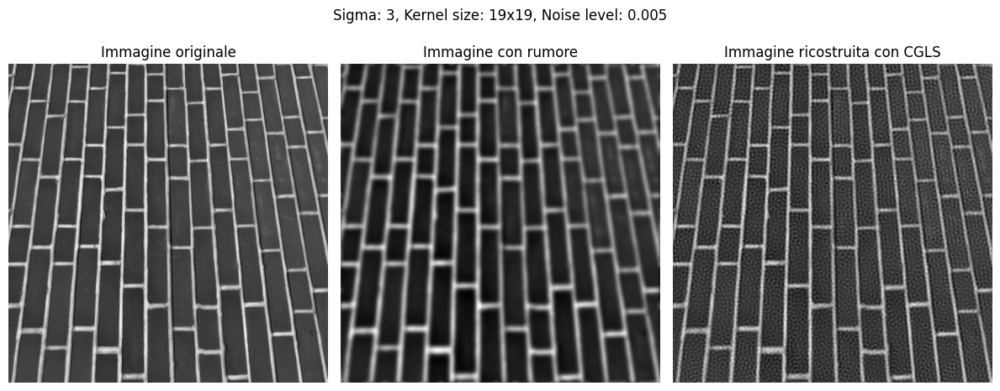

CGLS converge in 501 interazioni a causa di kmax.
CGLS converge in 1001 interazioni a causa di kmax.
CGLS converge in 1113 interazioni a causa di tol.


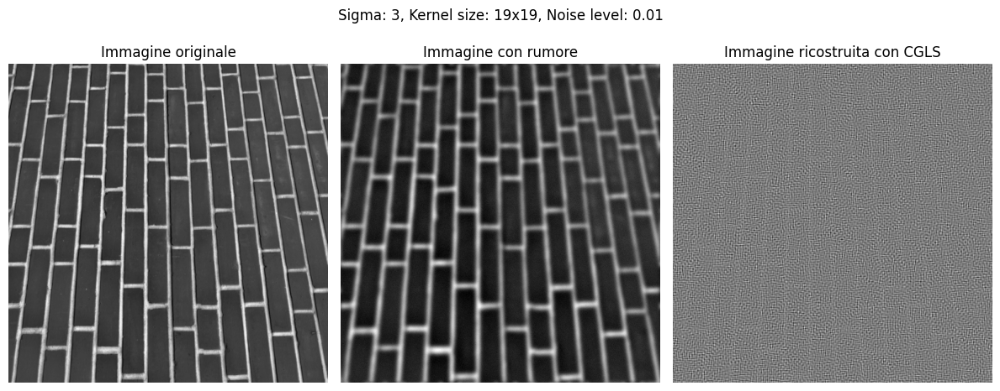

In [548]:
x0 = np.zeros_like(x)
kmax_cgls: list = [500, 1000, 2000]
TOLF: float = 1e-2
TOLX: float = 1e-2

results_cgls = []

for (sigma, k_size), A, y in zip(psf_parameters, As, ys):
    for noise_level in noise_levels:
        y_delta = y + utilities.gaussian_noise(y, noise_level)
        
        last_solution = None
        last_k = None
        converged = False
        
        for kmax in kmax_cgls:
            cgls_solver = solvers.CGLS(A)
            x_cgls, k, info = cgls_solver.solve(y_delta, x0, kmax=kmax, tolf=TOLF, tolx=TOLX)
            
            last_solution = x_cgls
            last_k = k
            
            print(f"CGLS converge in {last_k} interazioni a causa di {info}.")
            
            if info != 'kmax':
                converged = True
                break
        
        results_cgls.append({
            'sigma': sigma,
            'k_size': k_size,
            'noise': noise_level,
            'kmax_used': kmax,
            'iterations': last_k,
            'solution': last_solution,
            'converged': converged
        })

        plt.figure(figsize=(12, 5))
        plt.suptitle(f'Sigma: {sigma}, Kernel size: {k_size}x{k_size}, Noise level: {noise_level}')

        plt.subplot(1, 3, 1)
        plt.imshow(x, cmap='gray')
        plt.title('Immagine originale')
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(y_delta, cmap='gray')
        plt.title('Immagine con rumore')
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(x_cgls, cmap='gray')
        plt.title('Immagine ricostruita con CGLS')
        plt.axis('off')
        plt.tight_layout()
        plt.show()

In [549]:
L = operators.Identity()
lambdas = [0.0001, 0.001, 0.01, 0.1, 1]

kmax_tik: list = [500, 1000, 2000]
pad: int = 512

results_tik = []

for (sigma, k_size), A, y in zip(psf_parameters, As, ys):
    y_bar = np.pad(y, ((0, pad), (0, 0)))
    for noise_level in noise_levels:
        y_delta = y + utilities.gaussian_noise(y, noise_level)
        ybar_delta = np.pad(y_delta, ((0, pad), (0, 0)))
        x0 = np.zeros_like(x)
        
        last_solution = None
        last_k = None
        converged = False
        
        for lmbda in lambdas:
            for kmax in kmax_tik:
                M = operators.TikhonovOperator(A, L, lmbda)
                clgs_tik_solver = solvers.CGLS(M)
                x_tik, k, info = clgs_tik_solver.solve(ybar_delta, x0, kmax=kmax_tik[-1], tolf=TOLF, tolx=TOLX)
                
                last_solution = x_tik
                last_k = k
                
                if info != 'kmax':
                    converged = True
                    break
            
            res = np.linalg.norm(A @ last_solution - y_delta)

            results_tik.append({
                'sigma': sigma,
                'k_size': k_size,
                'noise': noise_level,
                'lambda': lmbda,
                'kmax_used': kmax,
                'iterations': last_k,
                'solution': last_solution,
                'converged': converged,
                'residual': res
            })

In [ ]:
def select_lambda_discrepancy(results_tik: list, sigma: float, k_size: int, noise_level: float, y: np.ndarray, tau: float = 1.01):
    """
    Seleziona il valore di lambda basato sul livello di discrepanza.

    Parameters:
    results_tik (list): Lista dei risultati Tikhonov.
    sigma (float): Valore di sigma.
    k_size (int): Dimensione del kernel.
    noise_level (float): Livello di rumore.
    y (ndarray): Immagine osservata.
    tau (float, optional): Fattore di scala per il livello di discrepanza.

    Returns:
    tuple: (best_lambda, best_solution, best_residual, discrepancy_level, residuals)
    """
    subset = [r for r in results_tik if r['sigma'] == sigma and r['k_size'] == k_size and r['noise'] == noise_level]

    if len(subset) == 0:
        raise ValueError("Nessun risultato trovato per questi parametri.")
    
    lambdas = [r['lambda'] for r in subset]
    residuals = [r['residual'] for r in subset]
    solutions = [r['solution'] for r in subset]

    discrepancy_level = tau * noise_level * np.linalg.norm(y)
    
    best_i = np.argmin([abs(res - discrepancy_level) for res in residuals])
    best_lambda = lambdas[best_i]
    best_solution = solutions[best_i]
    best_residual = residuals[best_i]

    return best_lambda, best_solution, best_residual, discrepancy_level, residuals

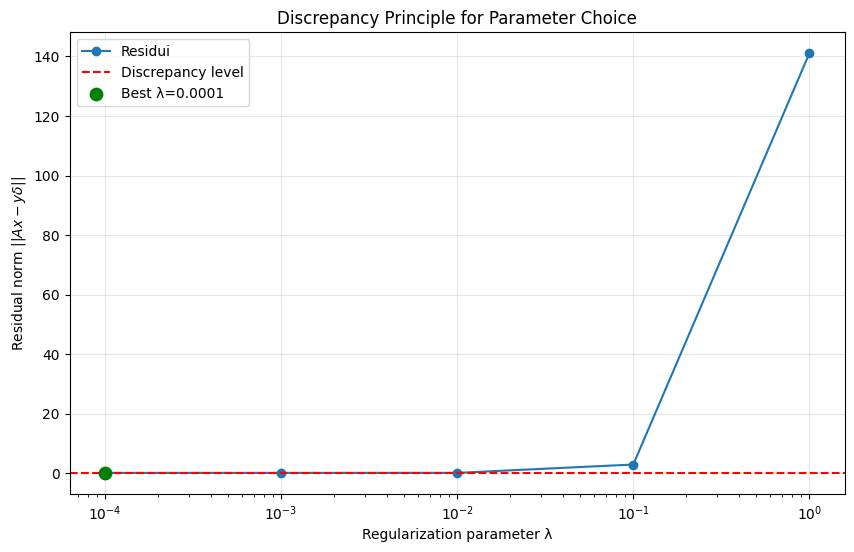

Sigma: 1.5, Kernel size: 11x11, Noise level: 0.0
Best λ (Discrepancy Principle): 0.0001
Residual at best λ: 0.0782
Discrepancy level: 0


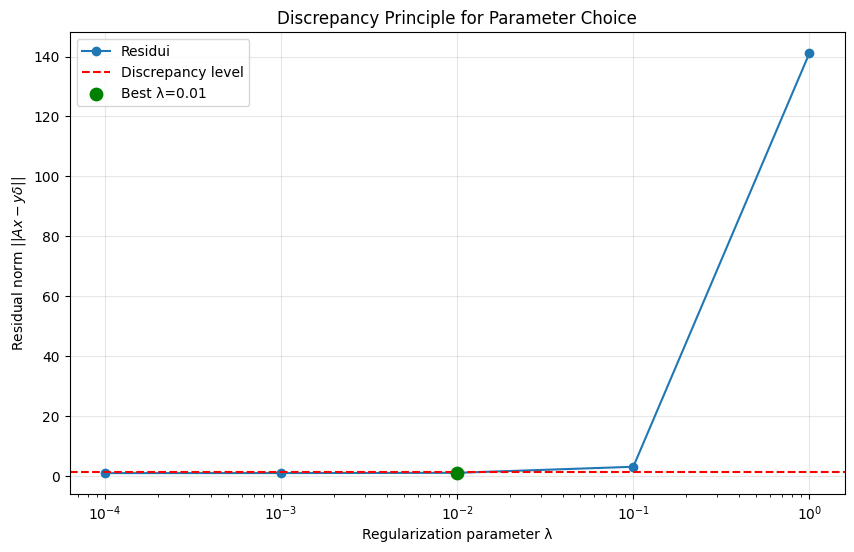

Sigma: 1.5, Kernel size: 11x11, Noise level: 0.005
Best λ (Discrepancy Principle): 0.01
Residual at best λ: 1.134
Discrepancy level: 1.417


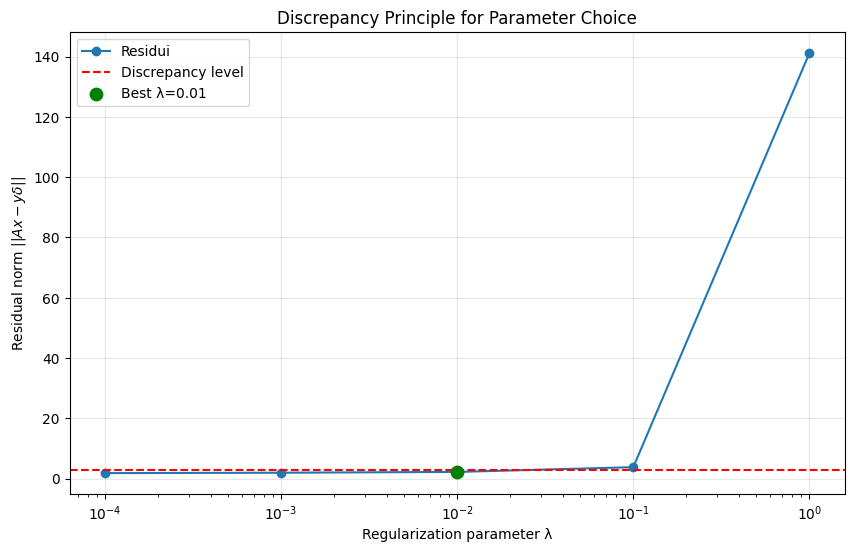

Sigma: 1.5, Kernel size: 11x11, Noise level: 0.01
Best λ (Discrepancy Principle): 0.01
Residual at best λ: 2.255
Discrepancy level: 2.834


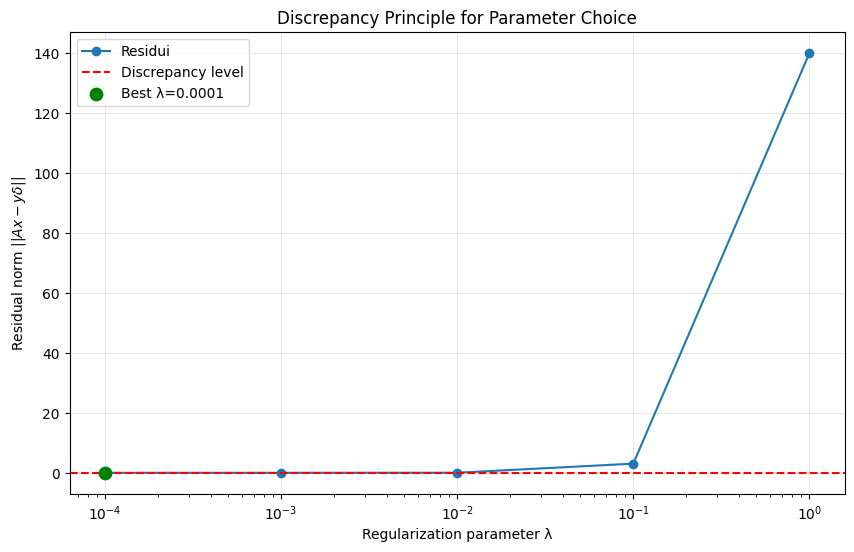

Sigma: 3, Kernel size: 19x19, Noise level: 0.0
Best λ (Discrepancy Principle): 0.0001
Residual at best λ: 0.1011
Discrepancy level: 0


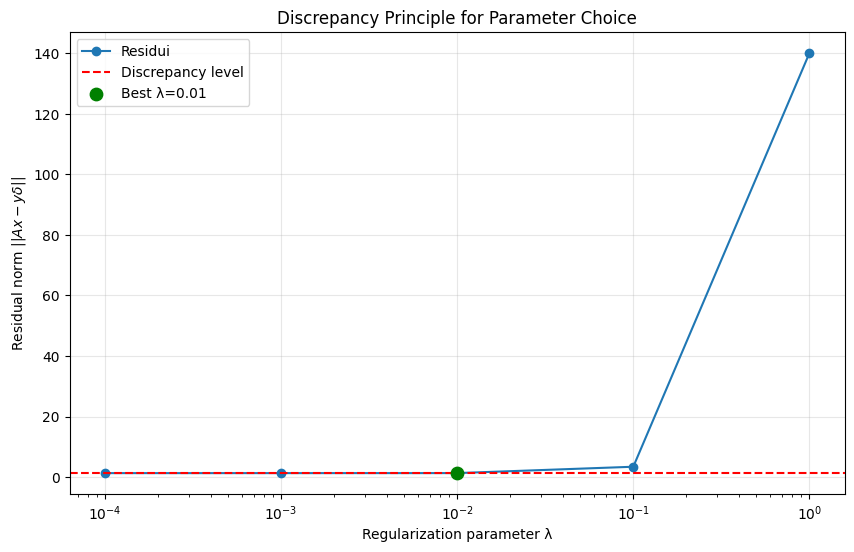

Sigma: 3, Kernel size: 19x19, Noise level: 0.005
Best λ (Discrepancy Principle): 0.01
Residual at best λ: 1.336
Discrepancy level: 1.406


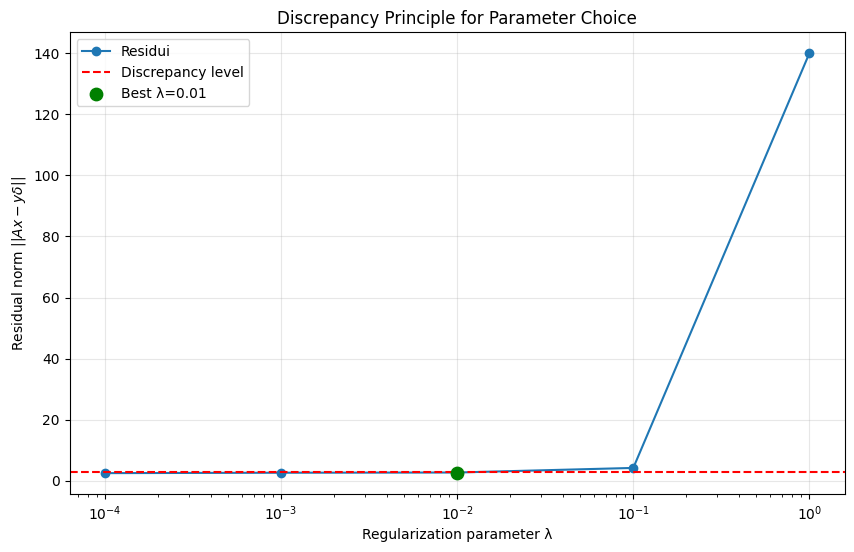

Sigma: 3, Kernel size: 19x19, Noise level: 0.01
Best λ (Discrepancy Principle): 0.01
Residual at best λ: 2.662
Discrepancy level: 2.812


In [551]:
best_results_ds = []

for (sigma, k_size), A, y in zip(psf_parameters, As, ys):
    for noise_level in noise_levels:
        best_lambda, best_solution, best_residual, discrepancy_level, residuals = select_lambda_discrepancy(results_tik, sigma, k_size, noise_level, y)
        
        best_results_ds.append({
            'sigma': sigma,
            'k_size': k_size,
            'noise': noise_level,
            'lambda': best_lambda,
            'solution': best_solution,
            'residual': best_residual,
            'discrepancy_level': discrepancy_level
        })
        
        plt.figure(figsize=(10, 6))
        plt.semilogx(lambdas, residuals, marker='o', label="Residui")
        plt.axhline(discrepancy_level, color='r', linestyle='--', label='Discrepancy level')
        plt.scatter(best_lambda, best_residual, color='g', s=80, zorder=5, label=f'Best λ={best_lambda}')
        plt.xlabel('Regularization parameter λ')
        plt.ylabel('Residual norm $||Ax - y\delta||$')
        plt.title('Discrepancy Principle for Parameter Choice')
        plt.grid(alpha=0.3)
        plt.legend()
        plt.show()
        
        print(f"Sigma: {sigma}, Kernel size: {k_size}x{k_size}, Noise level: {noise_level}")
        print(f"Best λ (Discrepancy Principle): {best_lambda:.4g}")
        print(f"Residual at best λ: {best_residual:.4g}")
        print(f"Discrepancy level: {discrepancy_level:.4g}")

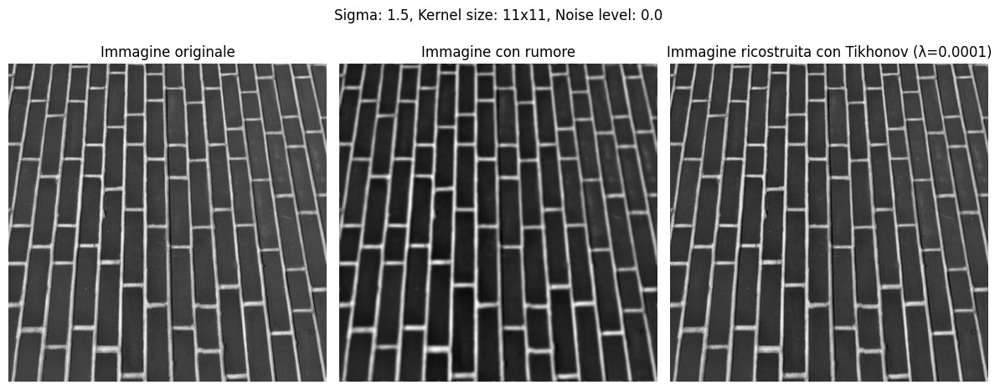

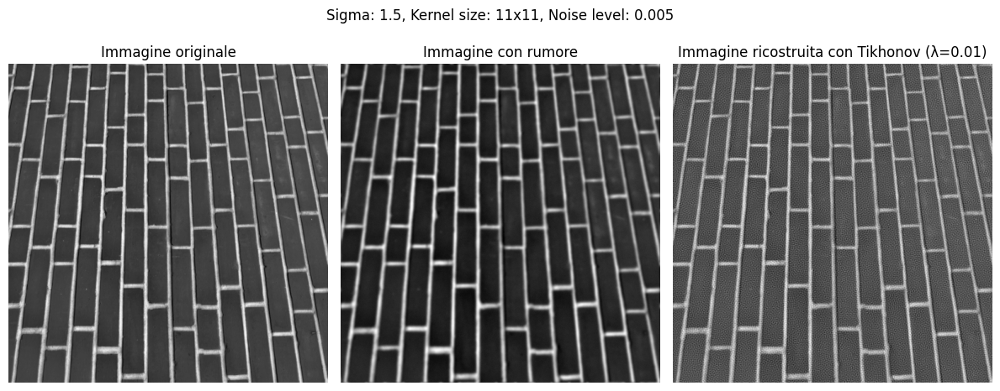

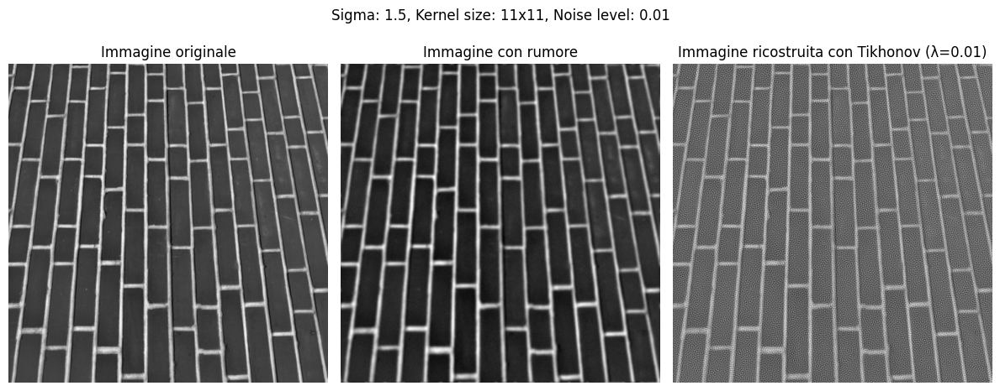

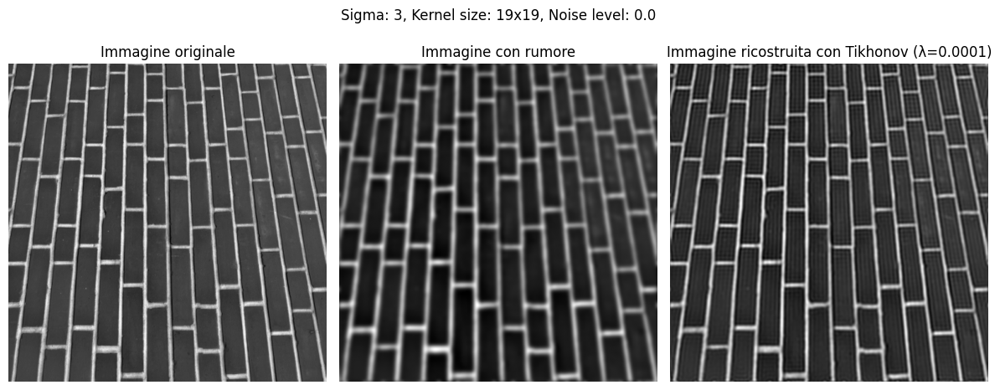

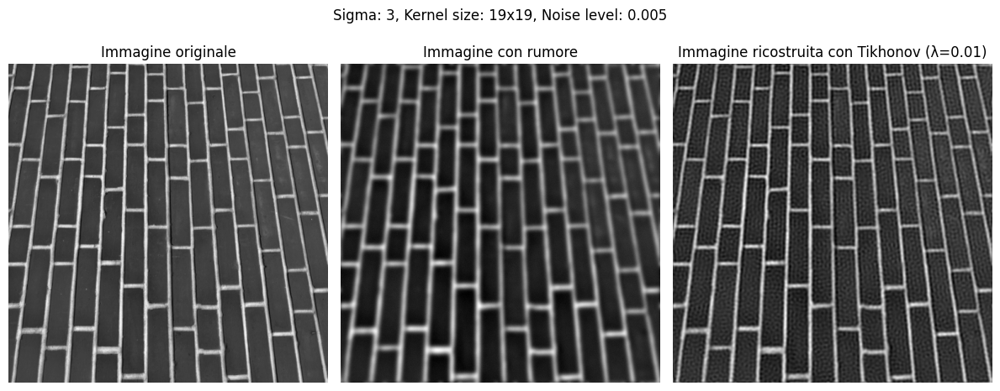

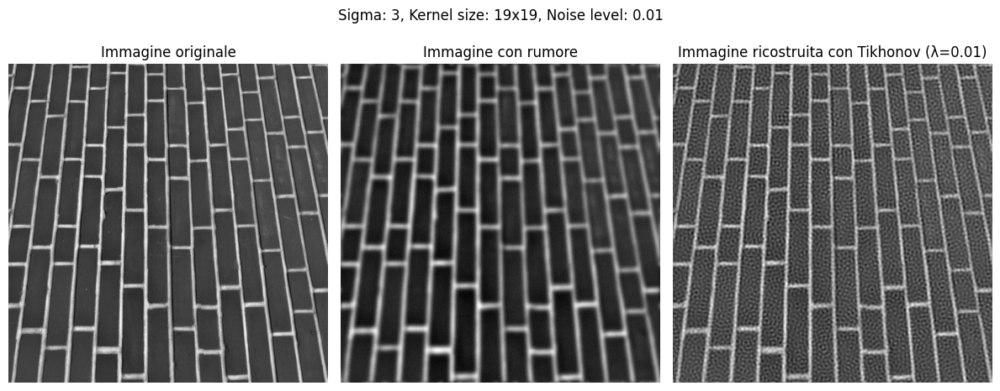

In [552]:
for result in best_results_ds:
    y_delta = ys[psf_parameters.index((result['sigma'], result['k_size']))] + utilities.gaussian_noise(ys[psf_parameters.index((result['sigma'], result['k_size']))], result['noise'])
    
    plt.figure(figsize=(12, 5))
    plt.suptitle(f'Sigma: {result["sigma"]}, Kernel size: {result["k_size"]}x{result["k_size"]}, Noise level: {result["noise"]}')
    
    plt.subplot(1, 3, 1)
    plt.imshow(x, cmap='gray')
    plt.title('Immagine originale')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(y_delta, cmap='gray')
    plt.title('Immagine con rumore')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(result['solution'], cmap='gray')
    plt.title(f'Immagine ricostruita con Tikhonov (λ={result["lambda"]:.4g})')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

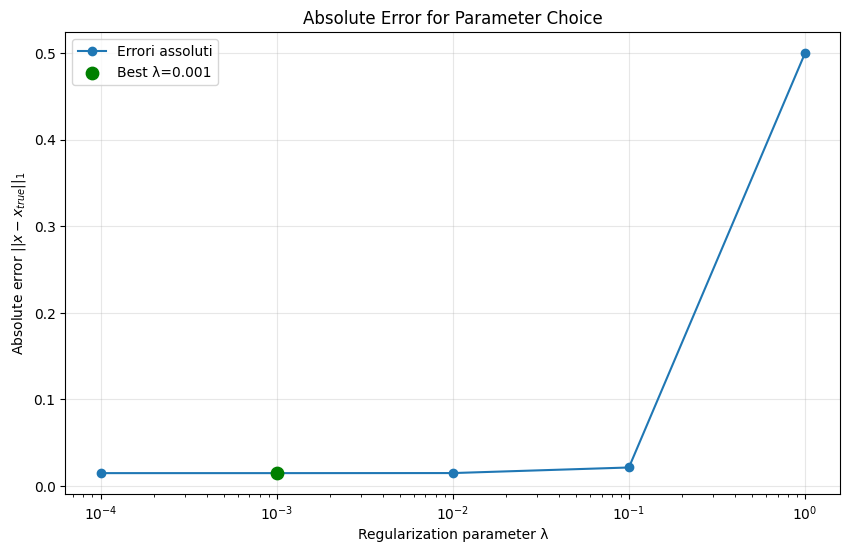

Sigma: 1.5, Kernel size: 11x11, Noise level: 0.0
Best λ (Absolute Error): 0.001
Absolute error at best λ: 0.01484


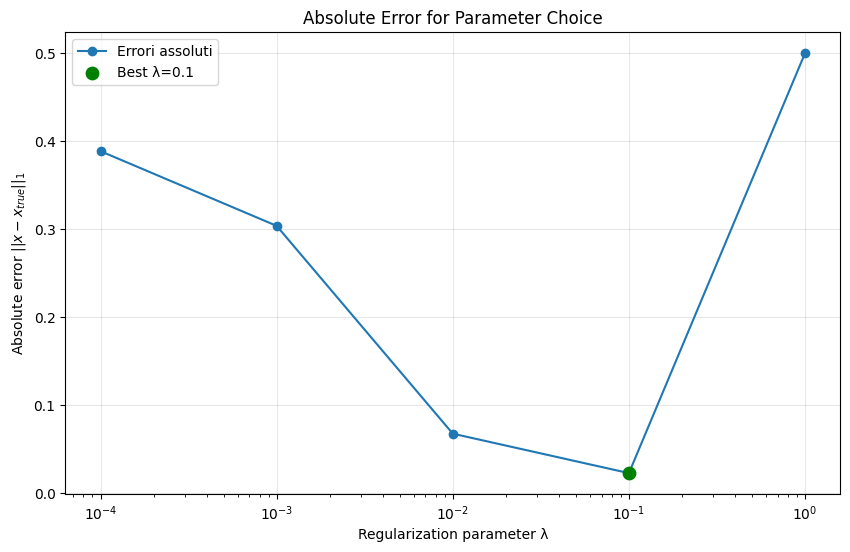

Sigma: 1.5, Kernel size: 11x11, Noise level: 0.005
Best λ (Absolute Error): 0.1
Absolute error at best λ: 0.02285


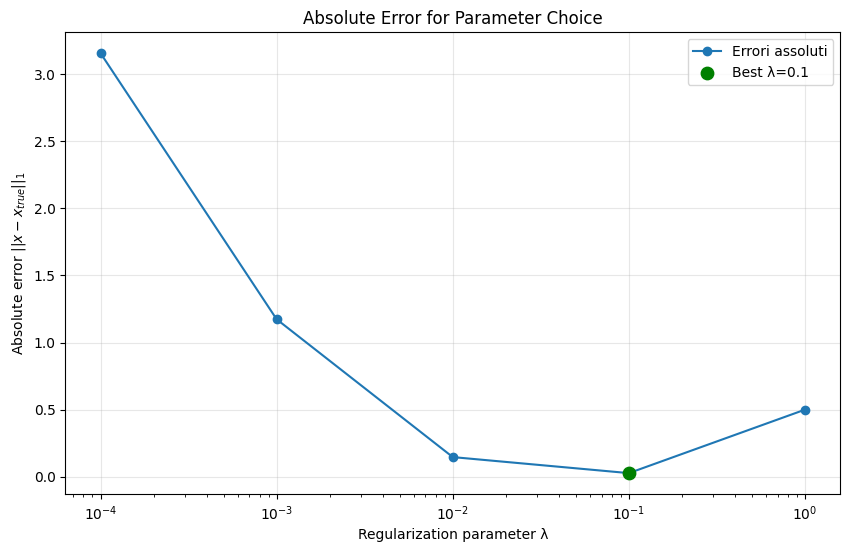

Sigma: 1.5, Kernel size: 11x11, Noise level: 0.01
Best λ (Absolute Error): 0.1
Absolute error at best λ: 0.02702


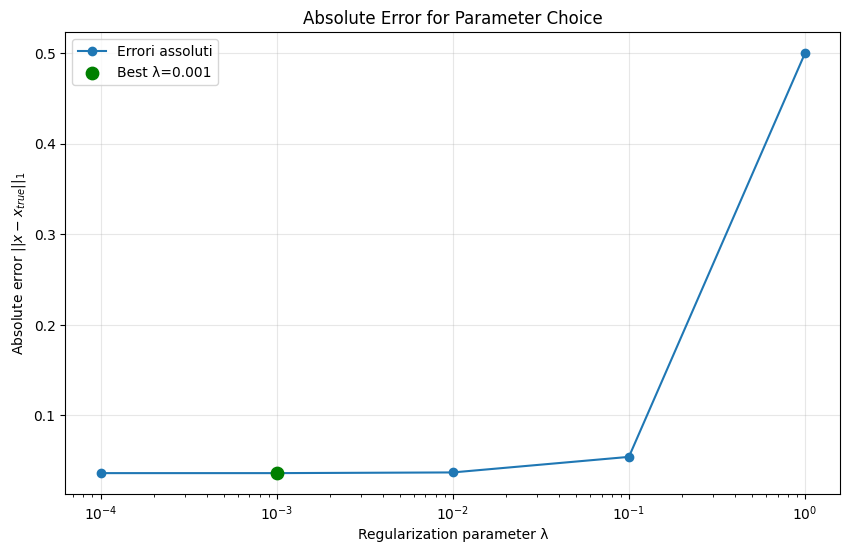

Sigma: 3, Kernel size: 19x19, Noise level: 0.0
Best λ (Absolute Error): 0.001
Absolute error at best λ: 0.03622


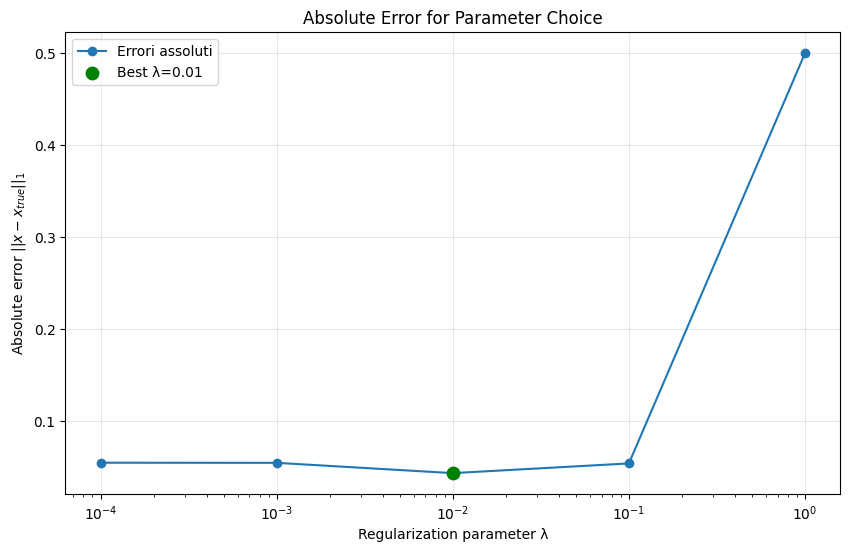

Sigma: 3, Kernel size: 19x19, Noise level: 0.005
Best λ (Absolute Error): 0.01
Absolute error at best λ: 0.04387


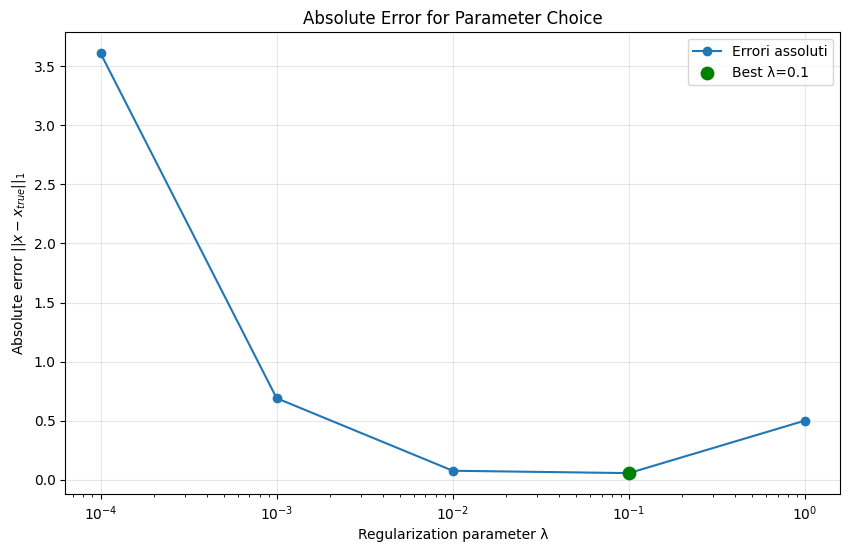

Sigma: 3, Kernel size: 19x19, Noise level: 0.01
Best λ (Absolute Error): 0.1
Absolute error at best λ: 0.05508


In [553]:
best_results_abs = []

for (sigma, k_size), A, y in zip(psf_parameters, As, ys):
    for noise_level in noise_levels:
        subset = [r for r in results_tik if r['sigma'] == sigma and r['k_size'] == k_size and r['noise'] == noise_level]

        if len(subset) == 0:
            raise ValueError("Nessun risultato trovato per questi parametri.")
        
        lambdas = [r['lambda'] for r in subset]
        solutions = [r['solution'] for r in subset]

        abs_errs = [np.sum(np.abs(r['solution'] - x)) / np.sum(np.abs(x)) for r in subset]

        best_i_abs = np.argmin(abs_errs)
        best_lambda_abs = lambdas[best_i_abs]
        best_solution_abs = solutions[best_i_abs]
        best_error_abs = abs_errs[best_i_abs]

        best_results_abs.append({
            'sigma': sigma,
            'k_size': k_size,
            'noise': noise_level,
            'lambda': best_lambda_abs,
            'solution': best_solution_abs,
            'absolute_error': best_error_abs
        })
        
        plt.figure(figsize=(10, 6))
        plt.semilogx(lambdas, abs_errs, marker='o', label="Errori assoluti")
        plt.scatter(best_lambda_abs, best_error_abs, color='g', s=80, zorder=5, label=f'Best λ={best_lambda_abs}')
        plt.xlabel('Regularization parameter λ')
        plt.ylabel('Absolute error $||x - x_{true}||_1$')
        plt.title('Absolute Error for Parameter Choice')
        plt.grid(alpha=0.3)
        plt.legend()
        plt.show()
        
        print(f"Sigma: {sigma}, Kernel size: {k_size}x{k_size}, Noise level: {noise_level}")
        print(f"Best λ (Absolute Error): {best_lambda_abs:.4g}")
        print(f"Absolute error at best λ: {best_error_abs:.4g}")

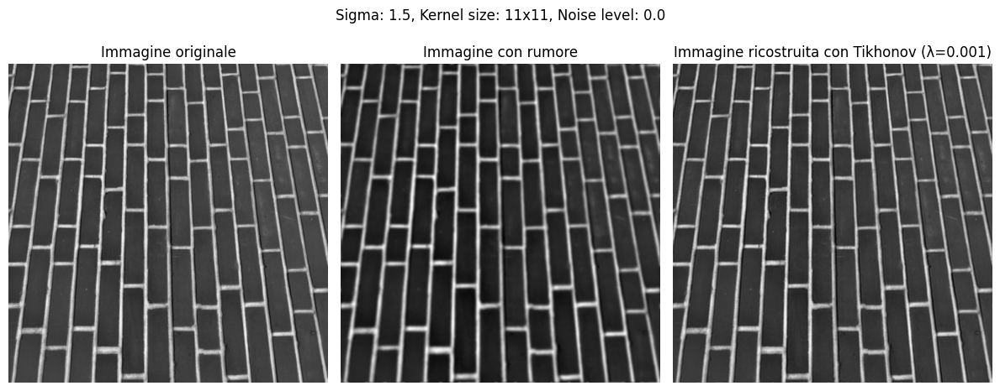

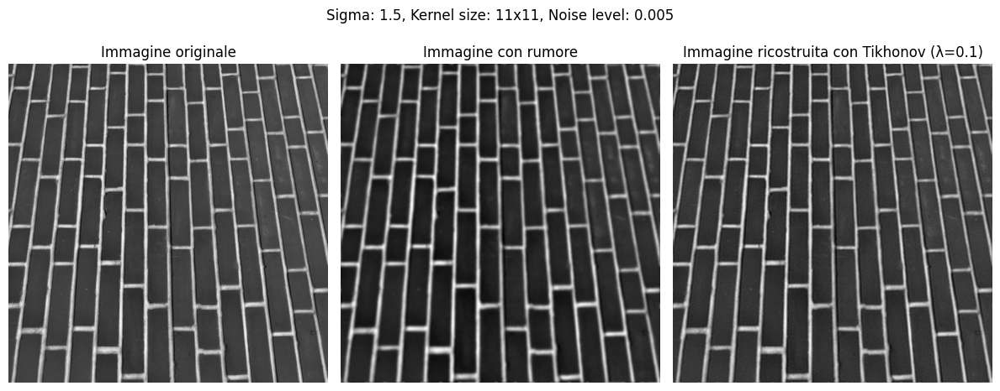

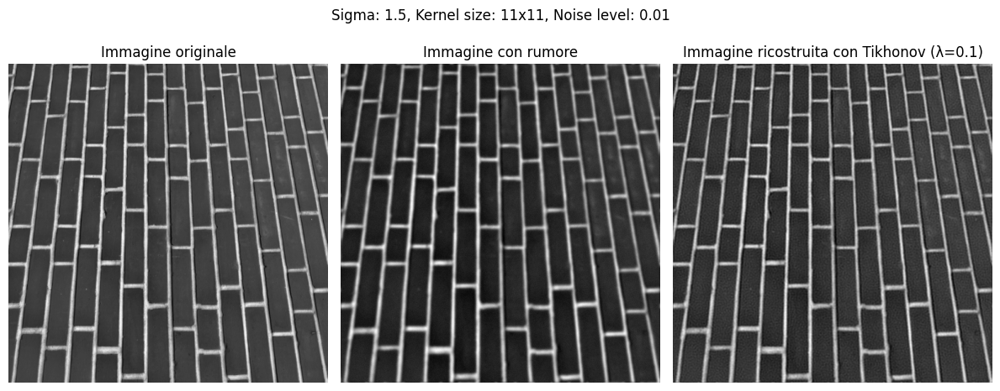

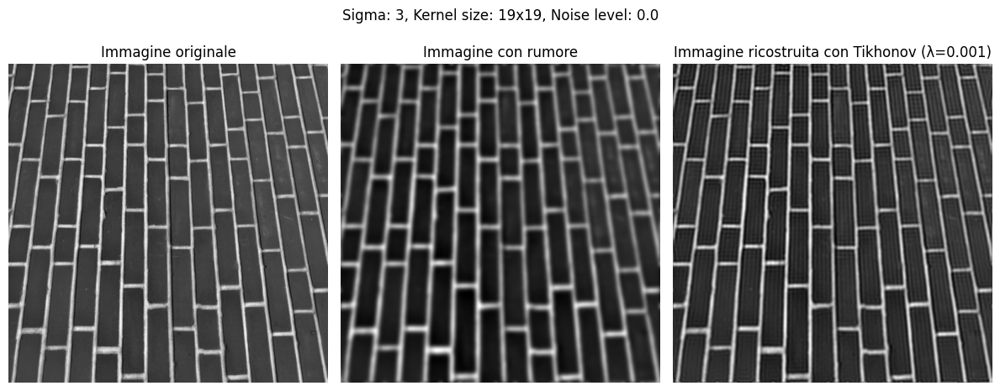

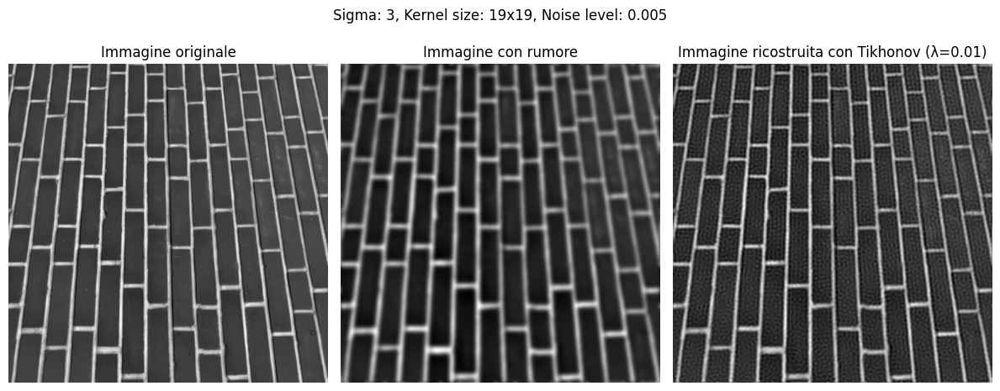

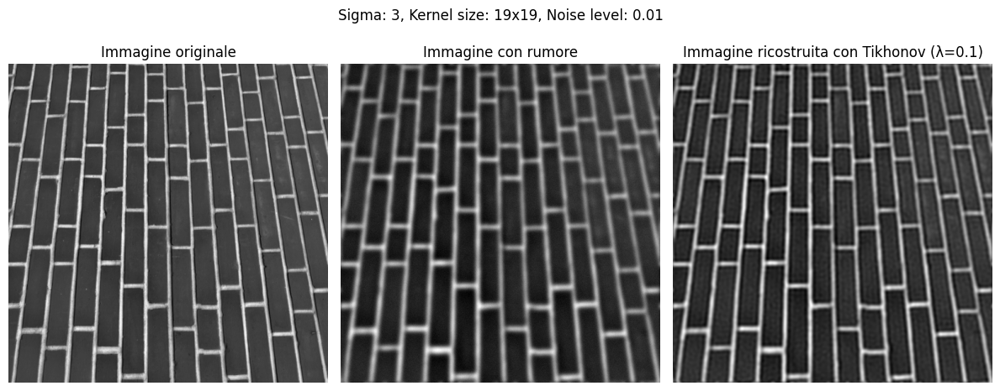

In [554]:
for result in best_results_abs:
    y_delta = ys[psf_parameters.index((result['sigma'], result['k_size']))] + utilities.gaussian_noise(ys[psf_parameters.index((result['sigma'], result['k_size']))], result['noise'])
    
    plt.figure(figsize=(12, 5))
    plt.suptitle(f'Sigma: {result["sigma"]}, Kernel size: {result["k_size"]}x{result["k_size"]}, Noise level: {result["noise"]}')
    
    plt.subplot(1, 3, 1)
    plt.imshow(x, cmap='gray')
    plt.title('Immagine originale')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(y_delta, cmap='gray')
    plt.title('Immagine con rumore')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(result['solution'], cmap='gray')
    plt.title(f'Immagine ricostruita con Tikhonov (λ={result["lambda"]:.4g})')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.


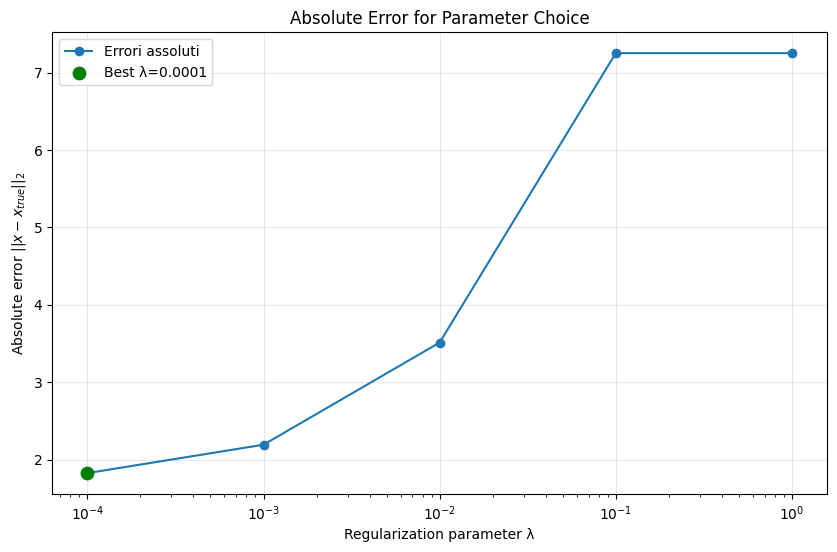

Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.


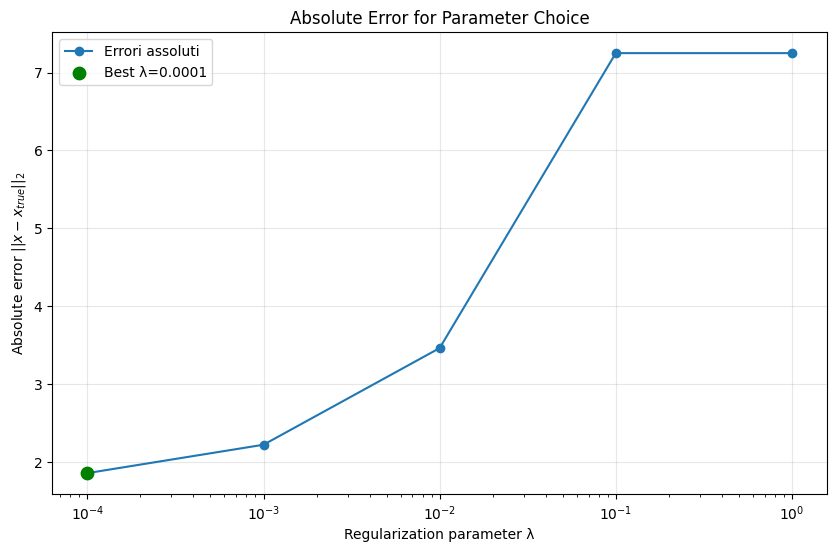

Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.


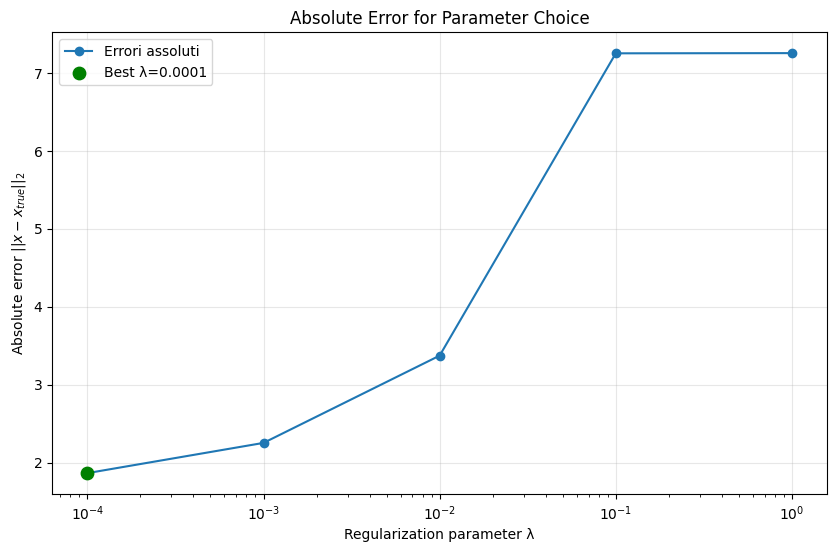

Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.


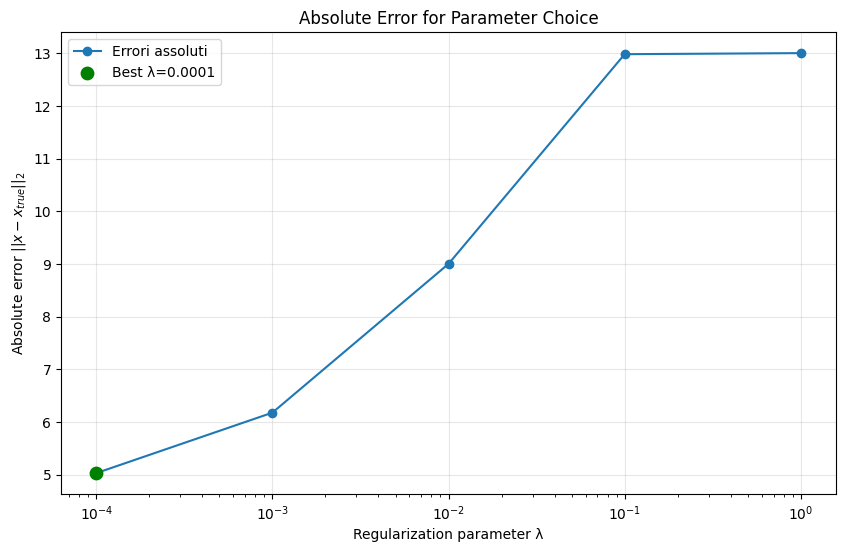

Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.


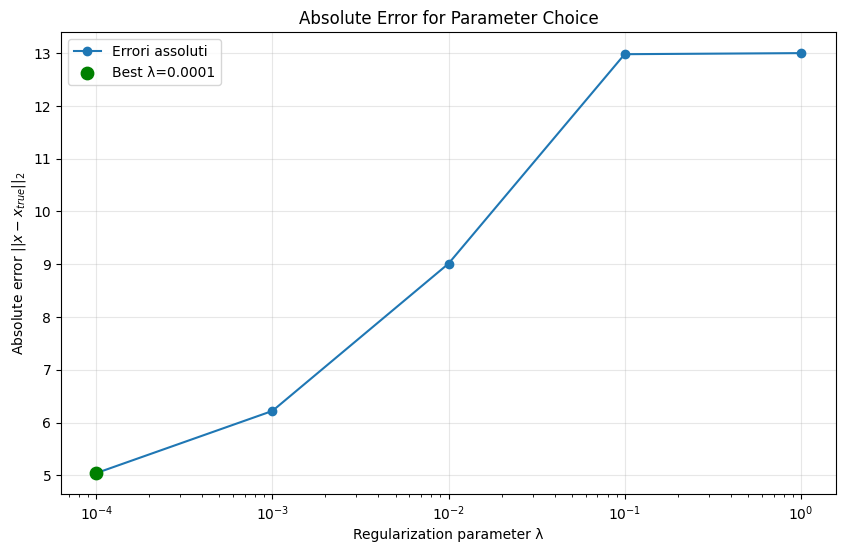

Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.
Algoritmo terminato per condizione su tolx.


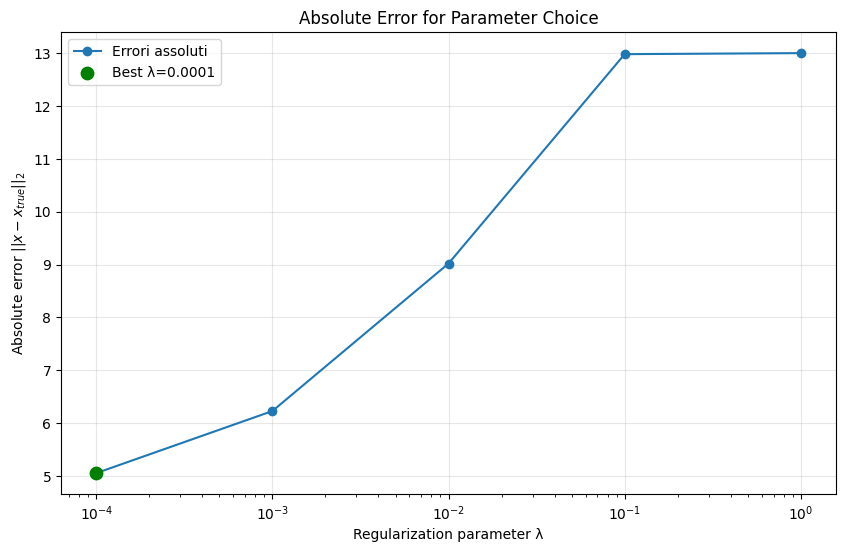

In [555]:
beta: float = 1e-3
KMAX_TV: int = 100

solutions_tv = []
best_solutions_tv = []

for (sigma, k_size), A, y in zip(psf_parameters, As, ys):
    gd_tv_solver = solvers.GDTotalVariation(A, beta=beta)
    for noise_level in noise_levels:
        y_delta = y + utilities.gaussian_noise(y, noise_level)
        
        for lmbda in lambdas:
            x_tv, obj_val, grad_norm = gd_tv_solver.solve(y_delta, lmbda, x0, kmax=KMAX_TV, tolf=TOLF, tolx=TOLX)
            
            abs_err = np.linalg.norm(x_tv - x, 2)
            
            solutions_tv.append({
                'sigma': sigma,
                'k_size': k_size,
                'noise': noise_level,
                'lambda': lmbda,
                'solution': x_tv,
                'absolute_error': abs_err,
            })
        
        subset = [r for r in solutions_tv if r['sigma'] == sigma and r['k_size'] == k_size and r['noise'] == noise_level]
        lambdas = [r['lambda'] for r in subset]
        abs_errs = [r['absolute_error'] for r in subset]
        solutions_list = [r['solution'] for r in subset]

        best_i_abs = np.argmin(abs_errs)
        best_lambda_abs = lambdas[best_i_abs]
        best_solution_abs = solutions_list[best_i_abs]
        
        best_solutions_tv.append({
            'sigma': sigma,
            'k_size': k_size,
            'noise': noise_level,
            'lambda': best_lambda_abs,
            'solution': best_solution_abs,
            'absolute_error': abs_errs[best_i_abs]
        })
        
        plt.figure(figsize=(10, 6))
        plt.semilogx(lambdas, abs_errs, marker='o', label="Errori assoluti")
        plt.scatter(best_lambda_abs, abs_errs[best_i_abs], color='g', s=80, zorder=5, label=f'Best λ={best_lambda_abs}')
        plt.xlabel('Regularization parameter λ')
        plt.ylabel('Absolute error $||x - x_{true}||_2$')
        plt.title('Absolute Error for Parameter Choice')
        plt.grid(alpha=0.3)
        plt.legend()
        plt.show()


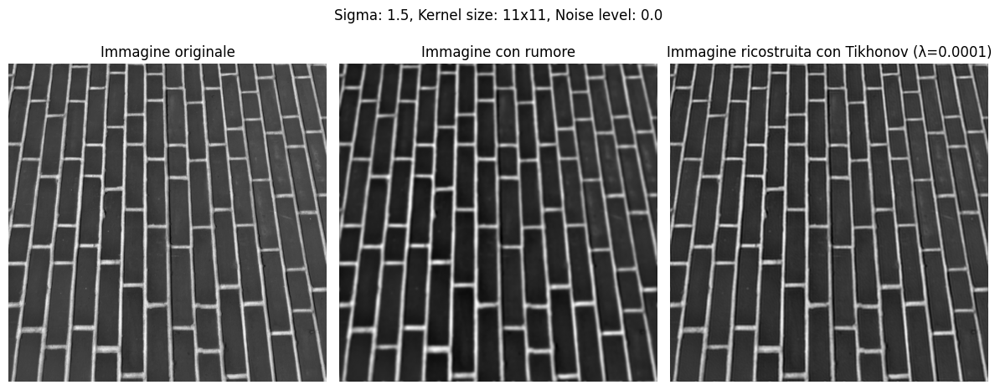

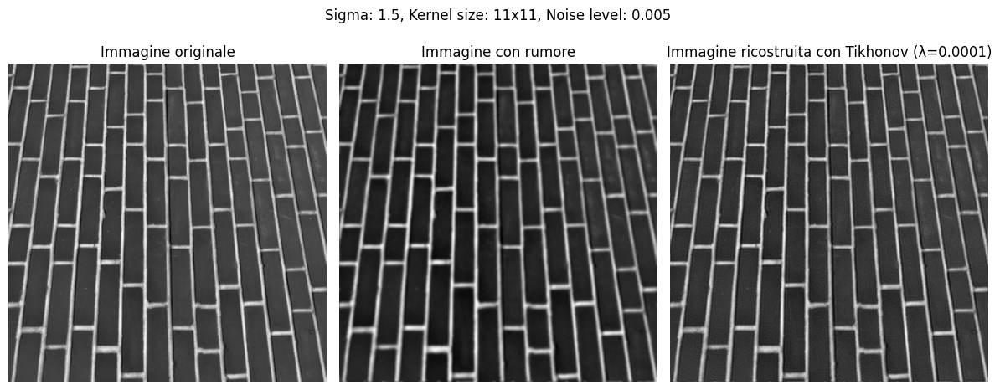

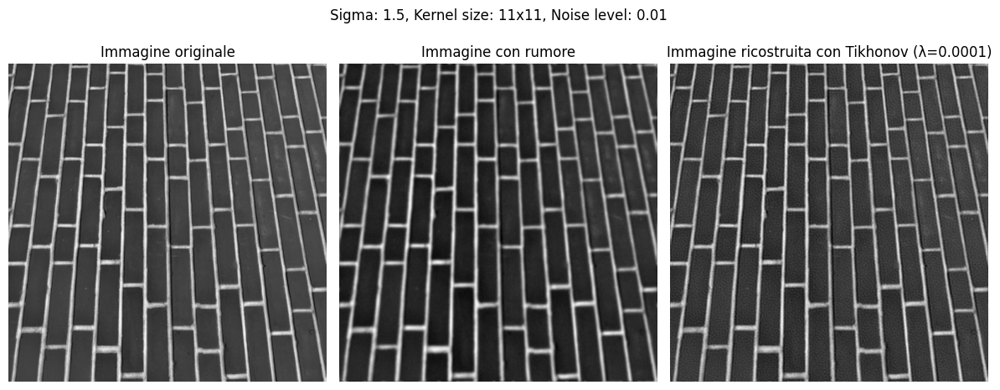

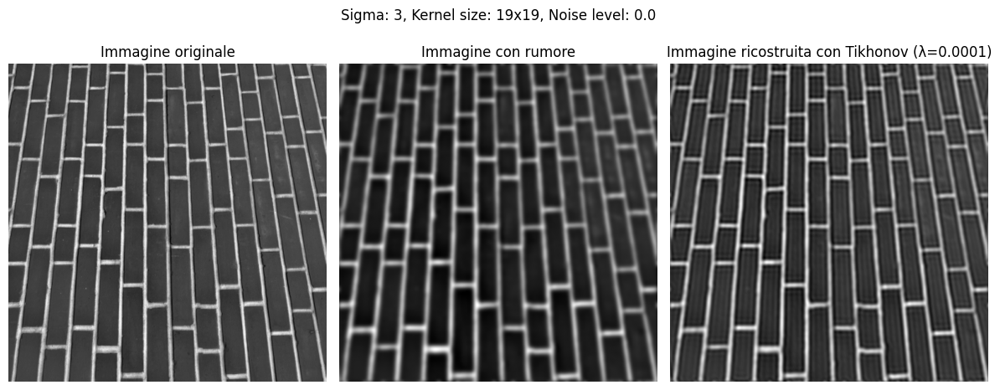

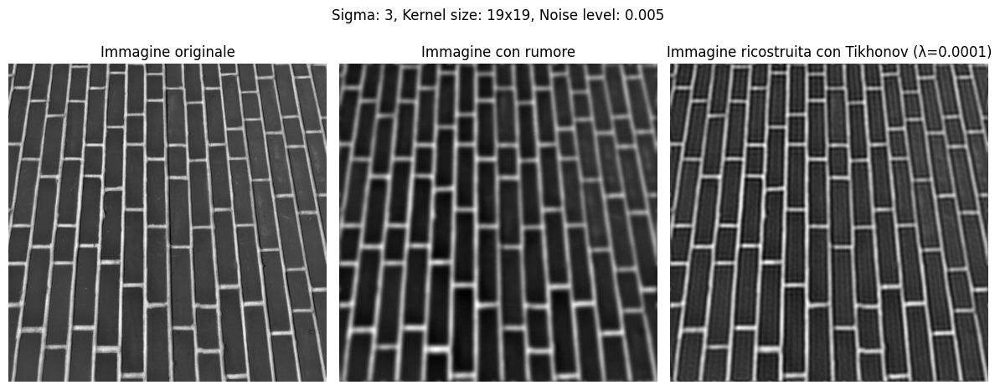

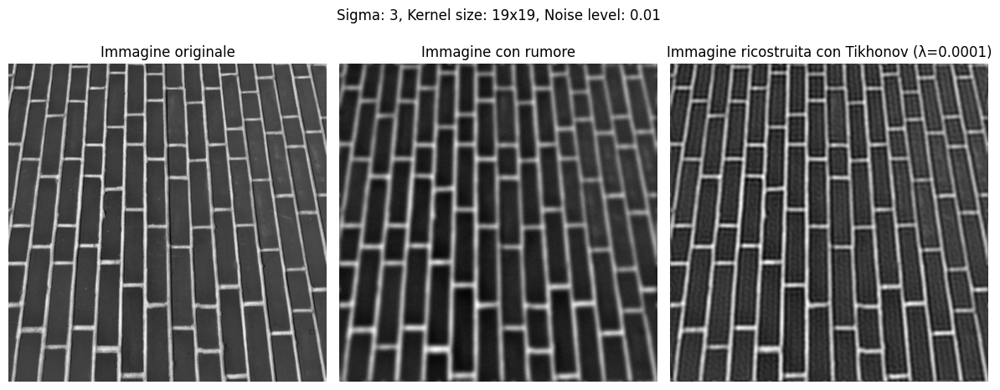

In [556]:
for result in best_solutions_tv:
    y_delta = ys[psf_parameters.index((result['sigma'], result['k_size']))] + utilities.gaussian_noise(ys[psf_parameters.index((result['sigma'], result['k_size']))], result['noise'])
    
    plt.figure(figsize=(12, 5))
    plt.suptitle(f'Sigma: {result["sigma"]}, Kernel size: {result["k_size"]}x{result["k_size"]}, Noise level: {result["noise"]}')
    
    plt.subplot(1, 3, 1)
    plt.imshow(x, cmap='gray')
    plt.title('Immagine originale')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(y_delta, cmap='gray')
    plt.title('Immagine con rumore')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(result['solution'], cmap='gray')
    plt.title(f'Immagine ricostruita con Tikhonov (λ={result["lambda"]:.4g})')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

Compariamo le metriche:

In [557]:
import pandas as pd
comparisons = []

for (sigma, k_size), A, y in zip(psf_parameters, As, ys):
    for noise_level in noise_levels:
        cgls_entry = next(r for r in results_cgls if r['sigma'] == sigma and r['k_size'] == k_size and r['noise'] == noise_level)
        x_cgls = cgls_entry['solution']
        er_cgls = utilities.rel_err(x_cgls, x)
        psnr_cgls = utilities.psnr(x_cgls, x)
        ssim_cgls = utilities.ssim(x_cgls, x)

        ds_entry = next(r for r in best_results_ds if r['sigma'] == sigma and r['k_size'] == k_size and r['noise'] == noise_level)
        x_ds = ds_entry['solution']
        er_ds = utilities.rel_err(x_ds, x)
        psnr_ds = utilities.psnr(x_ds, x)
        ssim_ds = utilities.ssim(x_ds, x)

        abs_entry = next(r for r in best_results_abs if r['sigma'] == sigma and r['k_size'] == k_size and r['noise'] == noise_level)
        x_abs = abs_entry['solution']
        er_abs = utilities.rel_err(x_abs, x)
        psnr_abs = utilities.psnr(x_abs, x)
        ssim_abs = utilities.ssim(x_abs, x)

        tv_entry = next(r for r in best_solutions_tv if r['sigma'] == sigma and r['k_size'] == k_size and r['noise'] == noise_level)
        x_tv = tv_entry['solution']
        er_tv = utilities.rel_err(x_tv, x)
        psnr_tv = utilities.psnr(x_tv, x)
        ssim_tv = utilities.ssim(x_tv, x)

        comparisons.append({
            'sigma': sigma,
            'k_size': k_size,
            'noise': noise_level,
            'CGLS_error': er_cgls,
            'CGLS_psnr': psnr_cgls,
            'CGLS_ssim': ssim_cgls,
            'Tikh_DS_error': er_ds,
            'Tikh_DS_psnr': psnr_ds,
            'Tikh_DS_ssim': ssim_ds,
            'Tikh_ABS_error': er_abs,
            'Tikh_ABS_psnr': psnr_abs,
            'Tikh_ABS_ssim': ssim_abs,
            'TV_error': er_tv,
            'TV_psnr': psnr_tv,
            'TV_ssim': ssim_tv,
        })

df_comparisons = pd.DataFrame(comparisons)
df_comparisons

,sigma,k_size,noise,CGLS_error,CGLS_psnr,CGLS_ssim,Tikh_DS_error,Tikh_DS_psnr,Tikh_DS_ssim,Tikh_ABS_error,Tikh_ABS_psnr,Tikh_ABS_ssim,TV_error,TV_psnr,TV_ssim
0,1.5,11,0.000,0.022254,38.198315,0.959131,0.022254,38.198311,0.959131,0.022255,38.197890,0.959133,0.027720,36.290634,0.937818
1,1.5,11,0.005,0.472214,11.663584,0.203982,0.082671,26.799269,0.556681,0.032231,34.980805,0.921314,0.030098,35.575677,0.908531
2,1.5,11,0.010,4.065170,-7.035207,0.061059,0.178762,20.100866,0.379144,0.035882,34.048767,0.856412,0.035541,34.131846,0.831779
3,3.0,19,0.000,0.049707,31.218005,0.777856,0.049707,31.217995,0.777856,0.049713,31.216952,0.777920,0.073418,27.830294,0.704081
4,3.0,19,0.005,0.068180,28.473284,0.621804,0.056791,30.060787,0.688952,0.056791,30.060787,0.688952,0.073660,27.801768,0.698982
5,3.0,19,0.010,4.376554,-7.676277,0.059009,0.092390,25.833840,0.529300,0.079514,27.137548,0.711149,0.074193,27.739130,0.688416


Possiamo notare che, il metodo naive con l'utilizzo di solo CGLS puro, funziona bene solo in assenza di rumore, anche un livello di rumore basso provoca un forte aumento del residuo, CGLS amplifica il rumore.
Per Tikhonov, la scelta del $\lambda$ basata sull'errore assoluto fornisce risultati migliori. Possiamo confermare che il principio di massima discrepanza è più sicura se non si è a conoscenza della ground truth.
Con rumore basso, le prestazioni della Total Variation sembrano leggermente inferiori rispetto a Tikhonov ma con l'aumentare del rumore si mantiene più stabile.

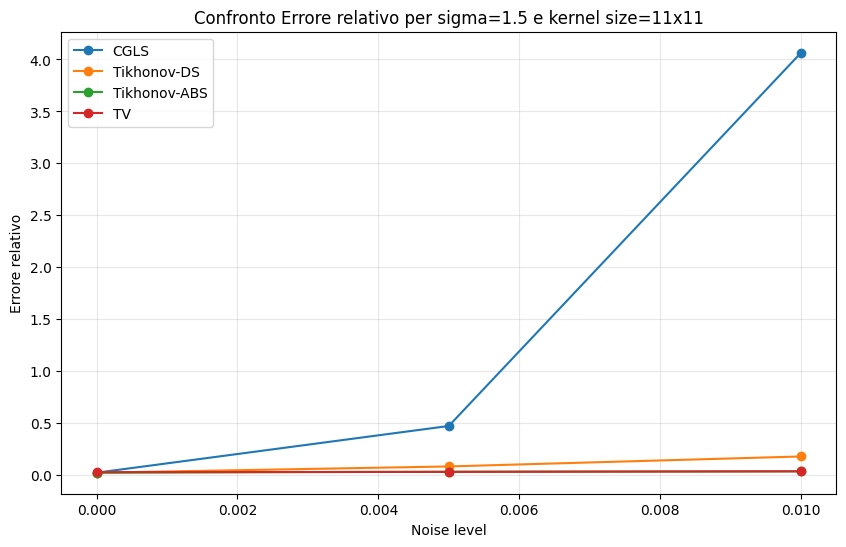

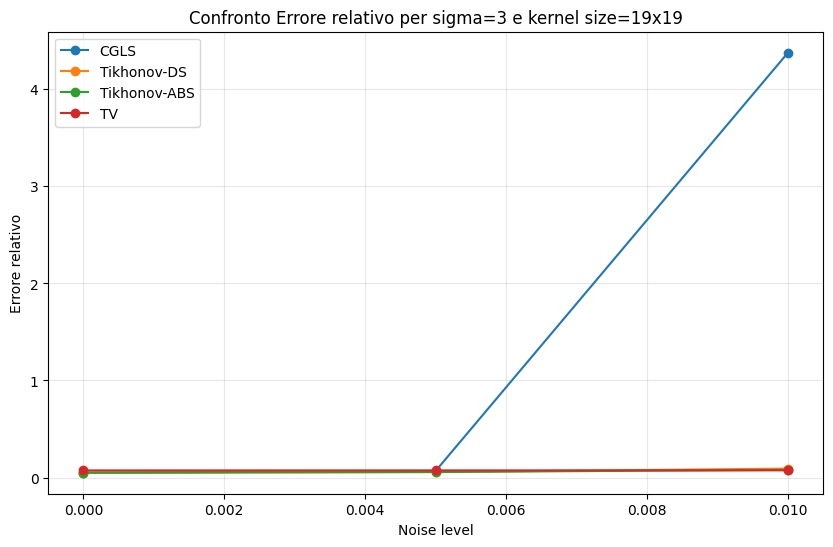

In [558]:
metrics = ['CGLS_error', 'Tikh_DS_error', 'Tikh_ABS_error', 'TV_error']
methods_labels = ['CGLS', 'Tikhonov-DS', 'Tikhonov-ABS', 'TV']

for sigma, k_size in psf_parameters:
    subset = df_comparisons[(df_comparisons['sigma'] == sigma) & (df_comparisons['k_size'] == k_size)]

    plt.figure(figsize=(10,6))
    for metric, label in zip(metrics, methods_labels):
        plt.plot(subset['noise'], subset[metric], marker='o', label=label)

    plt.title(f'Confronto Errore relativo per sigma={sigma} e kernel size={k_size}x{k_size}')
    plt.xlabel('Noise level')
    plt.ylabel('Errore relativo')
    plt.grid(alpha=0.3)
    plt.legend()
    plt.show()

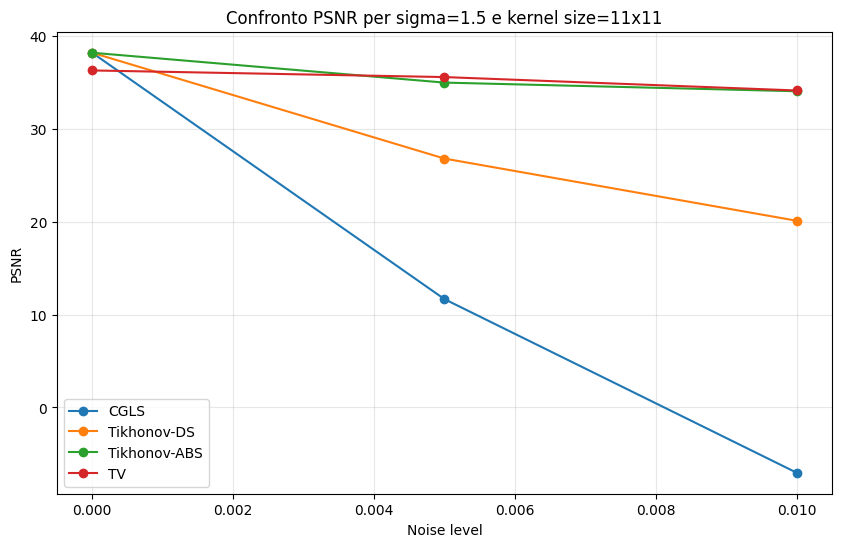

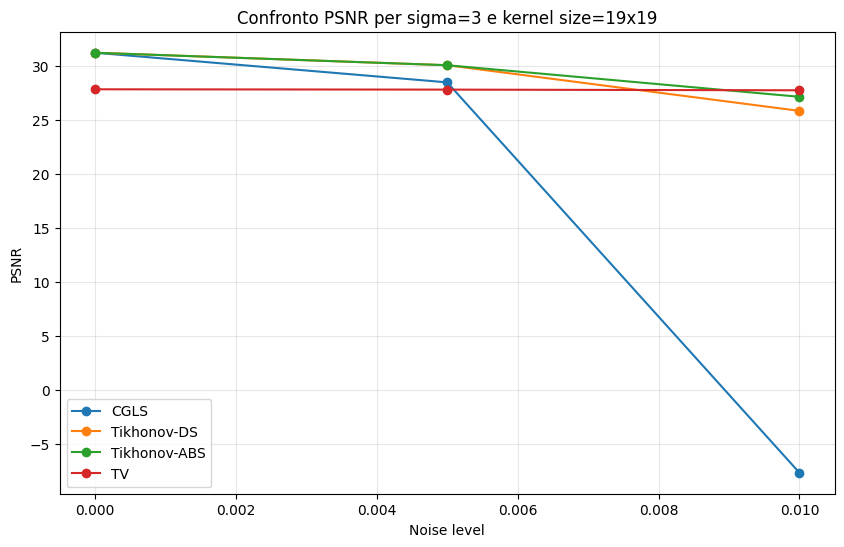

In [559]:
metrics = ['CGLS_psnr', 'Tikh_DS_psnr', 'Tikh_ABS_psnr', 'TV_psnr']
methods_labels = ['CGLS', 'Tikhonov-DS', 'Tikhonov-ABS', 'TV']

for sigma, k_size in psf_parameters:
    subset = df_comparisons[(df_comparisons['sigma'] == sigma) & (df_comparisons['k_size'] == k_size)]
    
    plt.figure(figsize=(10,6))
    for metric, label in zip(metrics, methods_labels):
        plt.plot(subset['noise'], subset[metric], marker='o', label=label)

    plt.title(f'Confronto PSNR per sigma={sigma} e kernel size={k_size}x{k_size}')
    plt.xlabel('Noise level')
    plt.ylabel('PSNR')
    plt.grid(alpha=0.3)
    plt.legend()
    plt.show()

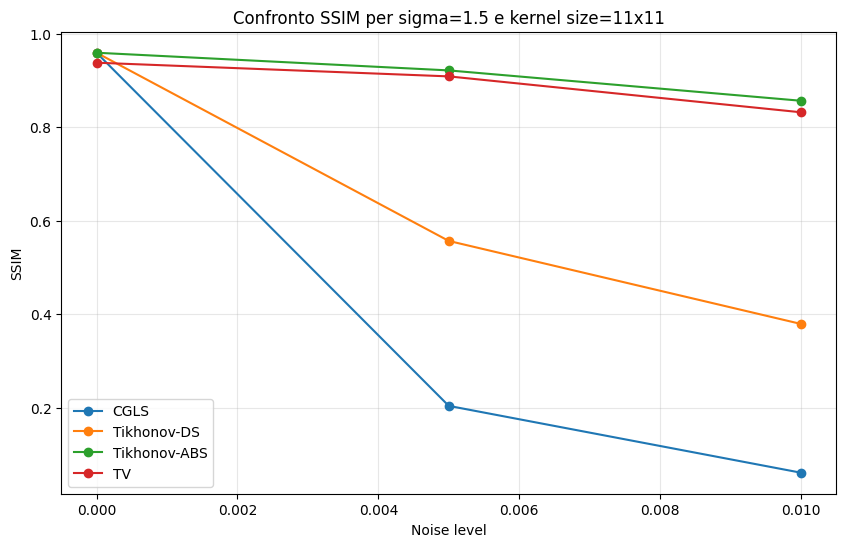

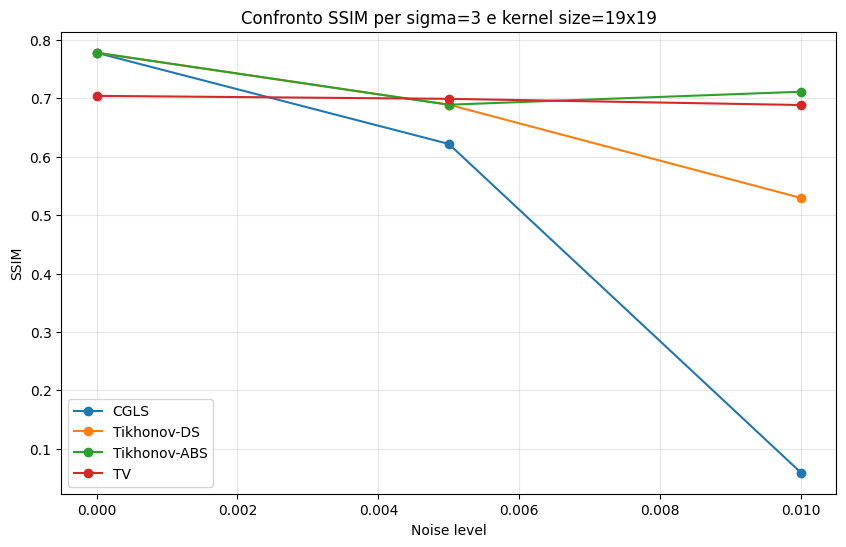

In [560]:
metrics = ['CGLS_ssim', 'Tikh_DS_ssim', 'Tikh_ABS_ssim', 'TV_ssim']
methods_labels = ['CGLS', 'Tikhonov-DS', 'Tikhonov-ABS', 'TV']

for sigma, k_size in psf_parameters:
    subset_sigma = df_comparisons[(df_comparisons['sigma'] == sigma) & (df_comparisons['k_size'] == k_size)]
    
    plt.figure(figsize=(10,6))
    for metric, label in zip(metrics, methods_labels):
        plt.plot(subset_sigma['noise'], subset_sigma[metric], marker='o', label=label)

    plt.title(f'Confronto SSIM per sigma={sigma} e kernel size={k_size}x{k_size}')
    plt.xlabel('Noise level')
    plt.ylabel('SSIM')
    plt.grid(alpha=0.3)
    plt.legend()
    plt.show()